# Data Wrangling

#### Student Name: ASHISH KHATANA
#### Student ID: 31163769

Date Started: 19/01/2020

Version: 1.0

Environment: Python 3.7.6 and Jupyter notebook

Libraries used: 
* matplot (for plotting graphs)
* re (for using regular expressions)
* zipfile (for dealing with zipfiles)
* nltk (for stemming words and language processing)
* tabula (for converting pdf tables into dataframes)
and more... listed in the importing libraries section

# Introduction
Combination of All the previous Assignments and aims to cover core concepts of Data Wrangling

# TASK-1 [DATA CLEANING]

In this Task, Data is fetched from `31163769_dirty_data.csv` file. Using different EDA/ non-EDA methods to understand the data and identify the errors in the data. Once the errors are identified they need to be fixed using appropriate methods. Finally, an output file `31163769_dirty_data_solution.csv` will be generated which contains the cleaned data.

## 1.1 Importing the Libraries

In [1]:
import pandas as pd #importing pandas library for handling files and working with dataframes
import matplotlib # importing matplot library for plotting graphs
import matplotlib.pyplot as plt # importing pyplot as plt
import numpy as np # for handling mathematical stuff like arrays
import re # for regular expressions
import nltk # importing neural language processing toolkit
from nltk.stem.porter import PorterStemmer # importin porter stemmer
from nltk.tokenize import word_tokenize # nltk wordtokenizer
import tabula # for reading PDF files
from zipfile import ZipFile # for unzipping dataset files
import zipfile # for unzipping zipped files
from math import sin, cos, sqrt, atan2, radians, ceil # for working with math functions

## 1.2 Reading the CSV file

In [2]:
dirty_data = pd.read_csv('31163769_dirty_data.csv') #reading the csv file into a dataframe 'dirty_data'

In [3]:
dirty_data #printing the dataframe to get a view of the data

,Unnamed: 0,ID,Latlng,Title,Age,Gender,Work_experience,Last_employment_date,Education,Sector,Salary
0,0,ID5173001,[-37.716412 145.141221],Mr,43,0.0,11,2019-01-28,1,Finance,4459.0
1,1,ID7480236,[-37.676334 145.029623],Dr,31,0.0,5,2019-12-02,1,Data Science,2740.0
2,2,ID5134169,[-37.694711 145.076598],Mrs,33,1.0,8,2019-08-30,0,Finance,3035.0
3,3,ID3649152,[-37.806727 145.081786],Mr,27,0.0,7,2018-11-13,1,IT,2524.0
4,4,ID7507958,[-37.982876 145.217315],NaN,29,1.0,9,2018-07-24,1,Data Science,4556.0
...,...,...,...,...,...,...,...,...,...,...,...
2905,1868,ID7270421,[-37.687552 145.073558],Mr,27,0.0,6,2019-06-19,0,Data Science,2263.0
2906,1873,ID5444327,[-37.836913 145.094352],Mr,33,0.0,7,2019-06-17,1,Finance,3084.0
2907,1874,ID3890186,[-37.807502 145.055251],Dr,49,0.0,12,2018-06-06,1,IT,3952.0
2908,1877,ID3149913,[-37.960321 145.045615],Mrs,58,1.0,15,2018-11-26,0,IT,4523.0


## 1.3 Analysing the Dataset
As mentioned in the requirements of this task, there are errors in the dataset, which needs to be identified and fixed using appropriate methods. In this step we'll just be getting an overview of the data.

As we can see from the above output of the dataframe there is an extra `Unnamed:0` column, which can be removed from the dataframe as it is not required as the values are also not in proper order (as compared to the index values shown)

In [4]:
dirty_data.drop('Unnamed: 0',inplace=True,axis=1) #removing the "Unnamed:0" Column and using inplace to make changes in the dataframe without making a copy.

In [5]:
dirty_data #displaying the modified dataframe to get a view of the data

,ID,Latlng,Title,Age,Gender,Work_experience,Last_employment_date,Education,Sector,Salary
0,ID5173001,[-37.716412 145.141221],Mr,43,0.0,11,2019-01-28,1,Finance,4459.0
1,ID7480236,[-37.676334 145.029623],Dr,31,0.0,5,2019-12-02,1,Data Science,2740.0
2,ID5134169,[-37.694711 145.076598],Mrs,33,1.0,8,2019-08-30,0,Finance,3035.0
3,ID3649152,[-37.806727 145.081786],Mr,27,0.0,7,2018-11-13,1,IT,2524.0
4,ID7507958,[-37.982876 145.217315],NaN,29,1.0,9,2018-07-24,1,Data Science,4556.0
...,...,...,...,...,...,...,...,...,...,...
2905,ID7270421,[-37.687552 145.073558],Mr,27,0.0,6,2019-06-19,0,Data Science,2263.0
2906,ID5444327,[-37.836913 145.094352],Mr,33,0.0,7,2019-06-17,1,Finance,3084.0
2907,ID3890186,[-37.807502 145.055251],Dr,49,0.0,12,2018-06-06,1,IT,3952.0
2908,ID3149913,[-37.960321 145.045615],Mrs,58,1.0,15,2018-11-26,0,IT,4523.0


Hence, the extra column has been removed and the above output shows the data that will be utilised for performing tasks below. 
Now let's look at the shape of the dataframe that we created in the last step and check for the null values in each of the columns.To do this we can use `.shape` & `.info()` methods on the dataframe,this will provide the information of the rows,columns,datatypes and other important info of each of the columns.

In [6]:
dirty_data.shape #Displaying the number of rows and columns of the dataframe

(2910, 10)

`.shape` function shows that there are `2910` rows and `10` columns in the dataframe. 

In [7]:
dirty_data.info() #getting an overview of the data, to look at the datatypes and see if there are complete values in the columns

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2910 entries, 0 to 2909
Data columns (total 10 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   ID                    2910 non-null   object 
 1   Latlng                2910 non-null   object 
 2   Title                 2877 non-null   object 
 3   Age                   2910 non-null   int64  
 4   Gender                2877 non-null   float64
 5   Work_experience       2910 non-null   int64  
 6   Last_employment_date  2910 non-null   object 
 7   Education             2910 non-null   int64  
 8   Sector                2877 non-null   object 
 9   Salary                2877 non-null   float64
dtypes: float64(2), int64(3), object(5)
memory usage: 227.5+ KB


`.info` method shows an overview of the data, now that we know that there are `2910` rows in the dataset, we can get a general idea whether there are any missing/null values in any of the columns. From above, we can see that `Title`,`Gender`,`Sector`,`Salary` Columns have `2877` values each, which are less than the total number of rows that we have, this means that these rows have missing values in them, let's analyse this using a dedicated function for looking at the null values.

In [8]:
dirty_data.isnull() #displays whether there are null values or not in the dataset in the form of True or False

,ID,Latlng,Title,Age,Gender,Work_experience,Last_employment_date,Education,Sector,Salary
0,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False
4,False,False,True,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...
2905,False,False,False,False,False,False,False,False,False,False
2906,False,False,False,False,False,False,False,False,False,False
2907,False,False,False,False,False,False,False,False,False,False
2908,False,False,False,False,False,False,False,False,False,False


Looking at values like this is not a convinient task, let's sum up these values to get the numerical count of each of the null values.

In [9]:
dirty_data.isnull().sum() #calculating the null values in each of the columns

ID                       0
Latlng                   0
Title                   33
Age                      0
Gender                  33
Work_experience          0
Last_employment_date     0
Education                0
Sector                  33
Salary                  33
dtype: int64

As we can see, there are 33 values missing in each of the following columns: `Title`,`Gender`,`Sector`,`Salary`. Now we have a general idea on the null values. We'll try to impute these in the later stages, after the deeply analysing each column for the errors.

# 1.4 Analysing each Column and Fixing the Erros
In this step we are going to analyse each of the columns seperately and progressively try to fix the errors and missing values.

## 1.4.1 'ID','Age' and 'work_experience' Columns
`ID`,`Age` and `work_experience` columns have no errors and they carry the correct data and information,as mentioned in the assignment specifications. Just like that 3 out of 10 columns are fixed :)

## 1.4.2 'Latlng' Column
`Latlng` Column consists of Latitude and Longitude Values or Location coordinates of the individuals in the dataset.
From the null value analysis we have already seen that there are no null values in `Latlng` Column. We can start with the analyis of what needs to be fixed in this column below.

In [10]:
Latlng=dirty_data['Latlng'] #fetching the value of the Latitude and Longitude column into Latlng variable

`Methodology`: This is one of the values of the column `[-37.716412 145.141221]`, We'll strip the square brackets and all the empty space at the begining and end of these values. Then after seperating the values into the different lists we'll use a simple logic to replace the values that needs to be swapped with each other and will also fix the `-` sign where ever necessary.

In [11]:
lati = [] # empty list for storing latitude values seperately 
longi = []  # empty list for storing longitude values seperately 

for i, coordinates in enumerate(Latlng): #Enumerating through the Latitude and Longitude values
    coordinates=coordinates.strip('[]') #removing the square brackets of each current value
    coordinates=coordinates.strip(' ') #stripping the space from each of the values (front and back)
    coordinates=coordinates.split(' ') #splitting the value into two based on the space between the characters
    lati.append(coordinates[0].strip('-')) #Taking the first part of the splitted value and 
                                           #stripping `-` from it & appending it into the latitude list
    longi.append(coordinates[-1].strip('-')) #Taking the last part of the splitted value and 
                                           #stripping `-` from it & appending it into the longitude list

Now, that we have the values seperated into two different lists, we can use the following logic to fix the values:

In [12]:
fixed_latitude=[] # list to store fixed latitude value
fixed_longitude=[] # list to store fixed longitude value
for longitude,latitude in zip(lati, longi): # using zip to work on both the list's current values together 
    if longitude < latitude: # if current value of longitude is less than value of the latitude the do the following
        swap = latitude     # storing the value of latitude into swap vairable
        latitude = longitude # replacing the value of latitude with the current value of longitude
        longitude = swap # now using the value from the swap variable assign it to longitude
        fixed_latitude.append(latitude) # now storing the fixed latitude value to the fixed_latitude list
        fixed_longitude.append(-float(longitude)) # now storing the fixed longitude value to the fixed_longitude list
    else: # if the above condition is false, just add the values to both the list respectively.
        fixed_latitude.append(latitude) # adding the fixed latitude value to the fixed_latitude list
        fixed_longitude.append(-float(longitude)) #  adding the fixed longitude value to the fixed_longitude list

`fixed_latitude` and `fixed_longitude` contains the fixed values of the coordinates into two seperate lists, as for the next step we'll combine these values and output into the desired format.

In [13]:
fixed_coordinates=[] #list that contains the fixed coordinate values concatinated together in the correct format
for i,j in zip(fixed_longitude, fixed_latitude): #iterating into both the lists in the zipped format
    joined_data="["+str(i) +" "+ str(j)+"]" #specifying the correct format as per the original column 
    fixed_coordinates.append(joined_data) # appending the value into the fixed_coordinates list

Finally, we have the fixed column value into a final list, let's preview the list and add it to the original dataframe.

In [14]:
fixed_coordinates #printing the fixed coordinates list

['[-37.716412 145.141221]',
 '[-37.676334 145.029623]',
 '[-37.694711 145.076598]',
 '[-37.806727 145.081786]',
 '[-37.982876 145.217315]',
 '[-37.938729 145.000502]',
 '[-37.759545 145.050391]',
 '[-37.715431 144.768827]',
 '[-37.603048 144.910852]',
 '[-37.78224 145.101328]',
 '[-37.777351 145.089039]',
 '[-37.864139 144.823887]',
 '[-37.815345 144.896756]',
 '[-37.72345 145.146772]',
 '[-37.773279 144.956732]',
 '[-37.98242 145.20147]',
 '[-37.74798584 145.00354]',
 '[-37.712905 144.971602]',
 '[-37.79623 144.901873]',
 '[-37.916704 145.034491]',
 '[-37.91196 145.254662]',
 '[-37.841411 144.8737599]',
 '[-37.581473 144.931049]',
 '[-37.86212 145.099701]',
 '[-37.760463 145.041251]',
 '[-37.773237 144.874591]',
 '[-37.940155 145.111468]',
 '[-37.75693 144.986093]',
 '[-37.710459 144.999627]',
 '[-37.766076 144.998052]',
 '[-37.809695 145.033198]',
 '[-37.81587219 144.9934082]',
 '[-37.943506 145.049038]',
 '[-37.815088 145.188465]',
 '[-37.646782 145.039104]',
 '[-37.87929153 144.981

In [15]:
dirty_data['Latlng']=fixed_coordinates # replacing the Latlng Column with the fixed list from the previous step

Hence, we've successfully fixed the latitude and longitude values and added it to the original dataframe.

In [16]:
dirty_data #printing the dataframe with fixed Latlng column

,ID,Latlng,Title,Age,Gender,Work_experience,Last_employment_date,Education,Sector,Salary
0,ID5173001,[-37.716412 145.141221],Mr,43,0.0,11,2019-01-28,1,Finance,4459.0
1,ID7480236,[-37.676334 145.029623],Dr,31,0.0,5,2019-12-02,1,Data Science,2740.0
2,ID5134169,[-37.694711 145.076598],Mrs,33,1.0,8,2019-08-30,0,Finance,3035.0
3,ID3649152,[-37.806727 145.081786],Mr,27,0.0,7,2018-11-13,1,IT,2524.0
4,ID7507958,[-37.982876 145.217315],NaN,29,1.0,9,2018-07-24,1,Data Science,4556.0
...,...,...,...,...,...,...,...,...,...,...
2905,ID7270421,[-37.687552 145.073558],Mr,27,0.0,6,2019-06-19,0,Data Science,2263.0
2906,ID5444327,[-37.836913 145.094352],Mr,33,0.0,7,2019-06-17,1,Finance,3084.0
2907,ID3890186,[-37.807502 145.055251],Dr,49,0.0,12,2018-06-06,1,IT,3952.0
2908,ID3149913,[-37.960321 145.045615],Mrs,58,1.0,15,2018-11-26,0,IT,4523.0


## 1.4.3 'Title', 'Gender', 'Education' and 'Sector' Columns

In [17]:
dirty_data['Title'] # viewing the Title Column from the dataframe

0        Mr
1        Dr
2       Mrs
3        Mr
4       NaN
       ... 
2905     Mr
2906     Mr
2907     Dr
2908    Mrs
2909     Mr
Name: Title, Length: 2910, dtype: object

From Section 1.3, we discovered that there are NULL values in Title Column. Now, we need to check for unique values present in the Title Column and proceed from there to fill the null values based on other columns.

In [18]:
dirty_data['Title'].unique() # using the unique method for the Title Column we can get a list of unique values

array(['Mr', 'Dr', 'Mrs', nan], dtype=object)

From the above overview, `Mr`,`Dr`,`Mrs` and `nan` (NULL) are the values present. If for instance we ignore the `nan` value, we can see that there are 3 titles in total: `Mr`,`Dr` and `Mrs`. Now to impute one of the following in place of `nan` we require more information from the other columns of the dataframe. Let's start with the Gender Column from the dataframe, we know from the first analysis that Gender column consists of Null values. Let's keep this as a starting point for futhur exploration.

In [19]:
dirty_data['Gender'].isnull().sum() #getting the overall count of the null values in the Gender Column

33

In [20]:
dirty_data['Gender'].unique() #Looking at the unique values in the Gender Column

array([ 0.,  1., nan])

From, the data description provided in the specifications of the assignment, 0:Male and 1:Female, and the third unknown nan value that we are getting is for the empty rows. Let's count the total number of present values based on Males/Females.

In [21]:
dirty_data['Gender'].value_counts() #Calculating the distribution of Males and Females

0.0    1950
1.0     927
Name: Gender, dtype: int64

We can interpret from the above data that the shear count of Males is higher than that of females in our dataset.To display this comparison graphically we can use matplot to plot the above data

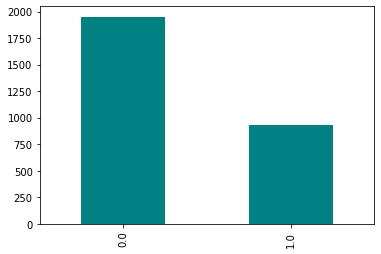

In [22]:
dirty_data['Gender'].value_counts().plot(kind="bar",color='teal') #plotting the distribution of Males and Females in our dataset

This comparison in itself doesn't help solve the issue of the empty values that we have, we may impute empty spaces with 0 (Males) as per the distribution that we are seeing here. But that would've been the case when we had only Gender Column to work with, but luckily we have another column `Title`, which contains the prefix of the individuals: `Mr`,`Mrs`,`Dr` (just like we saw a few sections above). Now we are going to check for `Title` rows/values where the `Gender` rows/values are empty.

In [23]:
dirty_data[dirty_data['Gender'].isnull()]['Title'].value_counts() #getting the value of Title where the Gender values are null

Mr     19
Mrs     8
Dr      6
Name: Title, dtype: int64

Just like that, we can now fill the empty data for the Gender column as follows:

`Mr`: Male (has to be set to 0)
`Mrs`: Female (has to be set to 1)
As for the 3rd prefix `Dr`, we have to look for other ways to fill those values, because both males and females can be doctors.

In [24]:
gender_data=dirty_data['Gender'] #getting the Gender Column data
title_data=dirty_data['Title'] #getting the Title Column data

In [25]:
gender_data #viewing the gender Column data

0       0.0
1       0.0
2       1.0
3       0.0
4       1.0
       ... 
2905    0.0
2906    0.0
2907    0.0
2908    1.0
2909    0.0
Name: Gender, Length: 2910, dtype: float64

In [26]:
title_data #viewing the title Column data

0        Mr
1        Dr
2       Mrs
3        Mr
4       NaN
       ... 
2905     Mr
2906     Mr
2907     Dr
2908    Mrs
2909     Mr
Name: Title, Length: 2910, dtype: object

In [27]:
import warnings # importing warnings to hide the pink box warnings
warnings.filterwarnings('ignore')  #https://stackoverflow.com/questions/9031783/hide-all-warnings-in-ipython

for current_value in dirty_data.index: #accessing the value at the index of the dataframe, inspiration: https://stackoverflow.com/questions/38569952/pandas-dataframe-meaning-of-index
    if title_data[current_value]=='Mr': #if the title of the null gender is "Mr", then the gender has to be Male
        gender_data[current_value]=0 # Hence, set the value of null row to 0, which resembles Males in our dataset
    elif title_data[current_value]=='Mrs': #if the title of the null gender is "Mr", then the gender has to be Male
        gender_data[current_value]=1 # Hence, set the value of null row to 1, which resembles Females in our dataset
    else: # if the above conditions are not true then don't change anything in the dataset
        pass # ignore the Dr Title, as we currently don't have any parameter to decide that

Now, that we have filled the Gender Values for title `Mr` and `Mrs`. We can again check for the null values in the Gender Column.

In [28]:
dirty_data['Gender'].isnull().sum() #to check the remaining null values in the Gender column

6

We get: 6 Null values in the Gender column, these 6 places are where the Title is Dr, we need to fill these values next. So, it's time to look at other columns to find more information on this.

`Work_experience`: Through work experience we might be able to get an idea, for the someone to use `Dr` prefix.

`Sector`: Consists of `IT`, `Finance` and `Data Science` sectors.

Let's Explore these columns.

In [29]:
dirty_data['Work_experience'].unique() #Displaying the unique values of the Work_experience Column

array([11,  5,  8,  7,  9,  3, 12,  2,  6,  4, 13, 19, 16, 15, 10, 28, 17,
       25, 18, 14, 26, 23, 22, 27, 21, 20, 24, 29])

From the description of the assignment we know that there are no errors or null values in the `Work_experience` Column of our dataset. So, now let's get `Work_experience` for the each of the `Gender` as a follows:

a) `Minimum` Work Experience

b) `Maxium` Work Experience

c) `Mean` Work Experience

In [30]:
dirty_data.groupby('Gender')['Work_experience'].min() # Getting the Minimum Work Experience for Each Gender

Gender
0.0    2
1.0    2
Name: Work_experience, dtype: int64

In [31]:
dirty_data.groupby('Gender')['Work_experience'].max() # Getting the Maximum Work Experience for Each Gender

Gender
0.0    29
1.0    29
Name: Work_experience, dtype: int64

In [32]:
dirty_data.groupby('Gender')['Work_experience'].mean() # Getting the Minimum Work Experience for Each Gender

Gender
0.0    8.968621
1.0    8.818750
Name: Work_experience, dtype: float64

The above results shows that both Male and Females have almost identical work experiences. Ideally `Dr` suffix should be for people with high work_experiences, but from our analysis we can clearly see that both Males and Females are equally qualified for the `Dr` Title. What we can do now is look at the different fields `Sector` that these people are working in. But to proceed with that, we firstly need to go through the Sector Column and alayse it.

In [33]:
dirty_data['Sector'].unique() #looking for unique values in the column, which should be out of the above 3

array(['Finance', 'Data Science', 'IT', nan, 'Financ', 'iT'], dtype=object)

On furthur exploration of Sector Column, we can see that there are few errors in the values as follows:
There are null values in this column as well as denoted by `nan`, we'll explore that part a bit later. For now, let's look at the errors.
    
`Financ` should be `Finance`
`iT` should be `IT`

as per the description given in the specifications of the assignment. We can replace the error values by using a simple code (below).

In [34]:
dirty_data['Sector'] = dirty_data['Sector'].map(lambda curr_value: 'Finance' if curr_value =='Financ' else ('IT' if curr_value == 'iT' else curr_value)) #https://www.geeksforgeeks.org/applying-lambda-functions-to-pandas-dataframe/

Now that the errors has been resolved, let's take a look at the unique values in the `Sector` column

In [35]:
dirty_data['Sector'].unique() #getting unique values in the column

array(['Finance', 'Data Science', 'IT', nan], dtype=object)

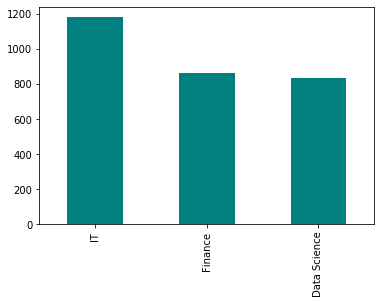

In [36]:
dirty_data['Sector'].value_counts().plot(kind="bar",color='teal') #Getting a visual view of the Sector data using matlplot

Hence, only null values needs to be replaced in the `Sector` column. Now, that the Data inside `Sector` Column is free of errors except null values we can compare it with the `Gender` of the workers. 

`Note:` Plot doesnot show nan values.

In [37]:
pd.crosstab(dirty_data['Gender'],dirty_data['Sector']) #https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.crosstab.html

Sector,Data Science,Finance,IT
Gender,,,
0.0,563,580,780
1.0,268,282,398


From the above tabular data we can see the distribution of each of the sectors based on the Gender. Now, let's look at the rows where the Gender is Null, i.e the remaing 6 rows which we were unable to fill in the above steps.

In [38]:
dirty_data[dirty_data['Gender'].isnull()]

,ID,Latlng,Title,Age,Gender,Work_experience,Last_employment_date,Education,Sector,Salary
110,ID7320693,[-37.765371 145.001436],Dr,30,NaN,5,2019-12-01,1,Data Science,2946.0
189,ID3989079,[-37.894482 144.992601],Dr,25,NaN,9,2018-11-15,1,IT,3120.0
2159,ID3543463,[-37.678718 145.117566],Dr,33,NaN,7,2018-09-25,1,IT,2704.0
2187,ID7694872,[-37.790123 145.322863],Dr,33,NaN,6,2019-01-27,1,Data Science,3131.0
2219,ID3449676,[-37.773543 144.953433],Dr,42,NaN,15,2019-10-23,1,IT,4869.0
2279,ID3260060,[-37.861594 145.260621],Dr,51,NaN,28,2019-10-30,1,IT,8950.0


The Table shows that the remaining null Gender values, for these null values `Title` is `Dr` and their experiences are also varying. But just from the experience alone we cannot figure out whether they are male or female, as both of them are equally qualified. So, Since the work_experience weight factor is equal on the both sides, we can add the most occuring value in the remaining 6 rows of the `Gender` Column from the rest of the rows.

In [39]:
dirty_data['Gender'].fillna(dirty_data['Gender'].mode().values[0],inplace=True) #filling the null values with the mode of Gender Column

FInally, the Gender Column has been fixed and all the null values has been dealt with. As a last check, let's look at the Gender Column for unique values and check for null values.

In [40]:
dirty_data['Gender'].unique() #Getting the unique values of the Gender Column to verify

array([0., 1.])

In [41]:
dirty_data['Gender'].isnull().sum() #Getting the total sum of the null values in the column

0

Hence, from above analysis we can say that there are no null values in teh Gender Column and the unique values suggest that there are only two values:`0` & `1` which means Males and Females. Let's get back to `Title` column as it has null values. Previously we looked for unique values in the `Title` Column and found out that the following are the unique values for `Title` Colum: `Mr`,`Mrs` & `Dr`.

To predict the null values of the Title Column, we have to compare and analysis it on the basis of other columns

In [42]:
dirty_data[dirty_data['Title'].isnull()]['Gender'].value_counts() #Looking for Null values in Title based on Gender Column

0.0    22
1.0    11
Name: Gender, dtype: int64

It would have been an instant fix, if we could just put `Mr` to Males and `Mrs` to Females. But there is a third `Title`, `Dr` which can be both either Male or Female. Just like we saw in the case of `Gender` Column.
So, let's look at the combined data of `Title` Column with regards to `Age`,`Work_experience` and `Salary` using different metrics like `min()`,`max()` and `mean()`.

In [43]:
dirty_data.groupby('Title')['Age','Work_experience','Salary'].min() #minimum values

,Age,Work_experience,Salary
Title,,,
Dr,25,2,1016.0
Mr,25,2,510.0
Mrs,25,2,708.0


In [44]:
dirty_data.groupby('Title')['Age','Work_experience','Salary'].max() #maximum values

,Age,Work_experience,Salary
Title,,,
Dr,64,29,12404.0
Mr,64,29,11849.0
Mrs,64,29,12416.0


In [45]:
dirty_data.groupby('Title')['Age','Work_experience','Salary'].mean() #mean values

,Age,Work_experience,Salary
Title,,,
Dr,35.784615,9.181538,3817.179012
Mr,35.154162,8.968933,3128.522335
Mrs,34.763593,8.758865,3244.612366


The above data is of no use as the distribution of `Age`, `Work_experience` and `Salary` is quite similar for `Mr` and `Mrs` but the `Salary` is quite high for the `Dr` Title.

In [46]:
dirty_data[dirty_data['Title'].isnull()]['Salary'].value_counts() #printing the salaries of Null titles

6161.0    1
4724.0    1
1017.0    1
1684.0    1
1461.0    1
1703.0    1
1624.0    1
1112.0    1
4640.0    1
2840.0    1
670.0     1
3126.0    1
3022.0    1
805.0     1
2746.0    1
1687.0    1
1118.0    1
4785.0    1
4565.0    1
1420.0    1
1593.0    1
3134.0    1
3084.0    1
3629.0    1
6531.0    1
3479.0    1
3061.0    1
6865.0    1
3351.0    1
3975.0    1
2517.0    1
7827.0    1
4556.0    1
Name: Salary, dtype: int64

In [47]:
pd.crosstab(dirty_data['Title'],[dirty_data['Education'],dirty_data['Sector']]) #comparing male and female salaries

Education            0                         1             
Sector    Data Science Finance   IT Data Science Finance   IT
Title                                                        
Dr                   0       1    1           96      91  132
Mr                 388     406  547          101     106  140
Mrs                191     199  278           43      53   71

In [48]:
for current_value in dirty_data[(dirty_data['Education']==0) & (dirty_data['Title'].isnull())].index:
    if dirty_data['Gender'][current_value] == 1:
        dirty_data['Title'][current_value] = 'Mrs'
    else:
        dirty_data['Title'][current_value] = 'Mr'

In [49]:
dirty_data['Title'].isnull().sum() #summing total null values in dirty_data

13

In [50]:
dirty_data['Title'].value_counts() #value count of Title

Mr     1720
Mrs     852
Dr      325
Name: Title, dtype: int64

In [51]:
#total people titles with higher education and in data science sector.
dirty_data[(dirty_data['Education'] ==1) & (dirty_data['Sector'] =='Data Science')]['Title'].value_counts()

Mr     101
Dr      96
Mrs     43
Name: Title, dtype: int64

In [52]:
#total people titles with data science sector and work experience higher than 25
dirty_data[(dirty_data['Sector']=='Data Science') & (dirty_data['Work_experience']>25)]['Title'].value_counts()

Mr     15
Mrs     3
Dr      2
Name: Title, dtype: int64

In [53]:
#total people titles in IT sector and work experience is less than 10 years
dirty_data[(dirty_data['Sector']=='IT') & (dirty_data['Work_experience']<10)]['Title'].value_counts()

Mr     497
Mrs    261
Dr      99
Name: Title, dtype: int64

In [54]:
dirty_data['Title'].fillna('Mr',inplace=True) #Mode, as Mr is occuring more frequently

In [55]:
dirty_data['Title'].isnull().sum() # summing up null values in Title

0

In [56]:
dirty_data.isnull().sum() #summing up all the null values in the dataframe

ID                       0
Latlng                   0
Title                    0
Age                      0
Gender                   0
Work_experience          0
Last_employment_date     0
Education                0
Sector                  33
Salary                  33
dtype: int64

In [57]:
dirty_data.groupby('Sector')['Age','Work_experience','Salary'].min() # getting the minimum values

,Age,Work_experience,Salary
Sector,,,
Data Science,25,2,656.0
Finance,25,2,642.0
IT,25,2,510.0


In [58]:
dirty_data.groupby('Sector')['Age','Work_experience','Salary'].max() #getting the maximum values

,Age,Work_experience,Salary
Sector,,,
Data Science,64,29,12416.0
Finance,64,29,10735.0
IT,64,29,9238.0


In [59]:
dirty_data.groupby('Sector')['Age','Work_experience','Salary'].mean() #calculating the overall mean

,Age,Work_experience,Salary
Sector,,,
Data Science,34.973589,8.864346,3709.854192
Finance,35.704176,9.373550,3511.687427
IT,34.713198,8.626058,2710.378632


In [60]:
pd.crosstab(dirty_data['Education'],dirty_data['Sector']) # Education division as per the Sector (0:Graduate|1:Higher)

Sector,Data Science,Finance,IT
Education,,,
0,587,610,834
1,246,252,348


In [61]:
pd.crosstab(dirty_data['Work_experience'],dirty_data['Sector']) #displaying work_experience with Sectors

Sector,Data Science,Finance,IT
Work_experience,,,
2,27,35,59
3,78,70,106
4,62,79,122
5,86,65,108
6,75,87,116
7,97,85,125
8,80,85,105
9,98,91,119
10,15,13,26


In [62]:
dirty_data[(dirty_data['Sector'].isnull()) & (dirty_data['Salary']>8000)] #where sector is null and salary 8000+

,ID,Latlng,Title,Age,Gender,Work_experience,Last_employment_date,Education,Sector,Salary
336,ID7808236,[-37.75680161 144.99086],Dr,41,0.0,19,2018-12-22,1,NaN,8296.0
410,ID7890535,[-37.757357 144.95458],Dr,63,1.0,20,2019-08-21,1,NaN,8790.0


It is difficult to come to a pattern, But from what we can see, that there is a certain degree of majority in this case. So, we'll use the mode to fill the values in Sector.

In [63]:
dirty_data['Sector'].fillna(dirty_data['Sector'].mode().values[0],inplace=True) #fill the empty value with mode()

In [64]:
dirty_data.corr() #getting an overview for correlation on the dataframes columns

,Age,Gender,Work_experience,Education,Salary
Age,1.000000,-0.012848,0.810522,0.026656,0.776853
Gender,-0.012848,1.000000,-0.012847,-0.007571,0.030262
Work_experience,0.810522,-0.012847,1.000000,0.015693,0.961889
Education,0.026656,-0.007571,0.015693,1.000000,0.163028
Salary,0.776853,0.030262,0.961889,0.163028,1.000000


In [65]:
dirty_data[dirty_data['Sector']=='IT'].corr() # correlation for Sector: IT

,Age,Gender,Work_experience,Education,Salary
Age,1.000000,-0.018439,0.806227,0.055199,0.794844
Gender,-0.018439,1.000000,-0.001415,0.003266,0.051610
Work_experience,0.806227,-0.001415,1.000000,0.027097,0.986520
Education,0.055199,0.003266,0.027097,1.000000,0.163031
Salary,0.794844,0.051610,0.986520,0.163031,1.000000


In [66]:
dirty_data[dirty_data['Sector']=='Data Science'].corr() # correlation for Sector: Datascience

,Age,Gender,Work_experience,Education,Salary
Age,1.000000,-0.000518,0.806475,0.021118,0.784152
Gender,-0.000518,1.000000,-0.050666,-0.028985,-0.016318
Work_experience,0.806475,-0.050666,1.000000,0.052223,0.982465
Education,0.021118,-0.028985,0.052223,1.000000,0.224399
Salary,0.784152,-0.016318,0.982465,0.224399,1.000000


In [67]:
dirty_data['Sector'].isnull().sum() # calculating the sum of all the null values in Sector.

0

## 1.4.4 'Last_employment_date' Column
During the formatting of the date format, below are the exceptions found, I had to manually handle these, as their dates were beyond their months' range.

In [68]:
dirty_data['Last_employment_date'] = dirty_data['Last_employment_date'].replace(['2018-06-31'],'2018-06-30')

In [69]:
dirty_data['Last_employment_date'] = dirty_data['Last_employment_date'].replace(['2018-02-30'],'2018-02-28')

In [70]:
dirty_data['Last_employment_date'] = dirty_data['Last_employment_date'].replace(['2018-04-31'],'2018-04-30')

In [71]:
dateee=dirty_data['Last_employment_date'] # storing the date in dateee

In [72]:
from datetime import datetime
d_fix=[] # creating an empty list that will consist of fixed date format

for date_current in dateee:# [1] Reference: https://stackoverflow.com/questions/16870663/how-do-i-validate-a-date-string-format-in-python/16870682
    try: # using try and except to handle the excepts which occurs due to a different date format.  
        if date_current == datetime.strptime(date_current,"%Y-%m-%d").strftime("%Y-%m-%d"):
            fixed_date = datetime.strptime(date_current,"%Y-%m-%d").strftime("%Y-%m-%d")
        d_fix.append(fixed_date) # appending the fixed format into the fixed date list
    except ValueError: # if the date format is not as per the specified format in try, we get a value error
        try:
            if date_current == datetime.strptime(date_current,"%d-%m-%Y").strftime("%Y-%m-%d"):            
                fixed_date = datetime.strptime(date_current,"%d-%m-%Y").strftime("%Y-%m-%d")          
            d_fix.append(fixed_date)     # appending the fixed format into the fixed date list   
        except ValueError: # if the date format is not as per the specified format in try, we get a value error
                if date_current == datetime.strptime(date_current,"%Y-%d-%m").strftime("%Y-%m-%d"):
                    fixed_date = datetime.strptime(date_current,"%Y-%d-%m").strftime("%Y-%m-%d")           
                d_fix.append(fixed_date) # appending the fixed format into the fixed date list

In [73]:
dirty_data['Last_employment_date']=d_fix

In [74]:
dirty_data

,ID,Latlng,Title,Age,Gender,Work_experience,Last_employment_date,Education,Sector,Salary
0,ID5173001,[-37.716412 145.141221],Mr,43,0.0,11,2019-01-28,1,Finance,4459.0
1,ID7480236,[-37.676334 145.029623],Dr,31,0.0,5,2019-12-02,1,Data Science,2740.0
2,ID5134169,[-37.694711 145.076598],Mrs,33,1.0,8,2019-08-30,0,Finance,3035.0
3,ID3649152,[-37.806727 145.081786],Mr,27,0.0,7,2018-11-13,1,IT,2524.0
4,ID7507958,[-37.982876 145.217315],Mr,29,1.0,9,2018-07-24,1,Data Science,4556.0
...,...,...,...,...,...,...,...,...,...,...
2905,ID7270421,[-37.687552 145.073558],Mr,27,0.0,6,2019-06-19,0,Data Science,2263.0
2906,ID5444327,[-37.836913 145.094352],Mr,33,0.0,7,2019-06-17,1,Finance,3084.0
2907,ID3890186,[-37.807502 145.055251],Dr,49,0.0,12,2018-06-06,1,IT,3952.0
2908,ID3149913,[-37.960321 145.045615],Mrs,58,1.0,15,2018-11-26,0,IT,4523.0


## 1.4.4 'Salary' Column

In [75]:
#using KNNImputer to get the value as a result of linear function
#https://scikit-learn.org/stable/modules/generated/sklearn.impute.KNNImputer.html
from sklearn.impute import KNNImputer #importing KNN imputer from sklearn
model_data = dirty_data[['Age','Gender','Work_experience','Education','Salary']] #getting the columns that salary depends on
model_data # printing the model data

,Age,Gender,Work_experience,Education,Salary
0,43,0.0,11,1,4459.0
1,31,0.0,5,1,2740.0
2,33,1.0,8,0,3035.0
3,27,0.0,7,1,2524.0
4,29,1.0,9,1,4556.0
...,...,...,...,...,...
2905,27,0.0,6,0,2263.0
2906,33,0.0,7,1,3084.0
2907,49,0.0,12,1,3952.0
2908,58,1.0,15,0,4523.0


In [76]:
#Reference: https://medium.com/@kyawsawhtoon/a-guide-to-knn-imputation-95e2dc496e#:~:text=KNN%20Imputer%20was%20first%20supported%20by%20Scikit-Learn%20in,%E2%80%98n_neighbors%E2%80%99%20nearest%20neighbors%20found%20in%20the%20training%20set.
Imput_Column = KNNImputer(n_neighbors=5) # Based on 5 nearest neighbours, which are actuall our 5 columns
model = Imput_Column.fit_transform(model_data) # fitting and tranforming the data to produce predictions

In [77]:
for current_value in dirty_data[dirty_data['Salary'].isnull()].index: # replacing null values in salary column based on index
    dirty_data['Salary'][current_value]=(model[current_value][4]) #4th index is for the Salary column in the model

In [78]:
dirty_data.isnull().sum() #summing the complete dataframe for counting null values

ID                      0
Latlng                  0
Title                   0
Age                     0
Gender                  0
Work_experience         0
Last_employment_date    0
Education               0
Sector                  0
Salary                  0
dtype: int64

In [79]:
dirty_data.to_csv('31163769_dirty_data_solution.csv') # exporting the csv file

# TASK-2 [PARSING AND PRE-PROCESSING TEXTUAL DATA]

## 2.1 Extracting the Tweets and Converting the Text file to JSON
This task follows the following steps/procedure:

1. Read the `31163769_tweets.txt` text File.
2. Extract the ID and Tweet Text from the text File
3. Combine the tweets with the same ID together.
4. Create a `31163769_tweets.json` JSON File from the combined data as per the specifed format

In [80]:
tweets_read = open('31163769_tweets.txt', 'r') # Reading the Tweets from the given textfile into the tweets_read

In [81]:
tweets_data=tweets_read.read() # assigning the value of the tweets_data with read method to tweets_data, so that it is accessible directly
tweets_data # printing the tweets data file

'EMPLOYEE_ID::ID3391357\nTWEET::@AndLester @colinrtalbot I can’t find where the 9,000 is coming from? Figures have been in region of 2,500 for last few weeks. https://t.co/y3gAroUpvj\nID::ID3958540\nTWEET::@Mamaleh3 Here they are in Virginia today. They have a whole lake and they must congregate in a tight group. \n\n#SocialDistancing #coronavirus #trumpanzeesaredumb https://t.co/3Xr5hLQErR\nUSER_IDD::ID5661201\nPUBLISHED_TWEET::Coronavirus: Cannes, Sundance, other film festivals unite for global streaming event - [Coronavirus], Source: Al Arabiya - https://t.co/Gy60yCZMCy https://t.co/L5LC8xNTSl\nID::ID3387865\nTWEET::@CecyPotharst @DeAnna4Congress @realDonaldTrump its...its literally a fact dummy😂😂\n\n12k died from Obama and Biden handling H1N1\n\n70k from Trump Handling Covid \n\nhttps://t.co/3lamBXOxmq\nID::ID5989789\nTWEET::@nytimes The Novel Coronavirus has a hook with which it attaches to the mucus membrane. Hydroxychloroquine disables the DNA chain of the hook. People either do

After reading the file, now we'll use regular expressions to extract the ID and Tweets from the `tweets_data` into two seperate lists.

In [82]:
regex_id = "::ID......." #Regular Expression for Getting ID from the textfile
regex_tweet = "TWEET::.*" #Regular Expression for Extracting Tweet Text from the textfile
id_match = re.findall(regex_id, tweets_data) #Storing the IDs into the 'id_match' list
tweet_match= re.findall(regex_tweet, tweets_data) #Storing the tweets into the 'tweet_match' list

In [83]:
id_match[:10] # printing the matched id data from the regular expression

['::ID3391357',
 '::ID3958540',
 '::ID5661201',
 '::ID3387865',
 '::ID5989789',
 '::ID5398255',
 '::ID5375452',
 '::ID7925437',
 '::ID3722874',
 '::ID5910672']

In [84]:
tweet_match[:10] # printing the matched tweet text data from the regular expression

['TWEET::@AndLester @colinrtalbot I can’t find where the 9,000 is coming from? Figures have been in region of 2,500 for last few weeks. https://t.co/y3gAroUpvj',
 'TWEET::@Mamaleh3 Here they are in Virginia today. They have a whole lake and they must congregate in a tight group. ',
 'TWEET::Coronavirus: Cannes, Sundance, other film festivals unite for global streaming event - [Coronavirus], Source: Al Arabiya - https://t.co/Gy60yCZMCy https://t.co/L5LC8xNTSl',
 'TWEET::@CecyPotharst @DeAnna4Congress @realDonaldTrump its...its literally a fact dummy😂😂',
 'TWEET::@nytimes The Novel Coronavirus has a hook with which it attaches to the mucus membrane. Hydroxychloroquine disables the DNA chain of the hook. People either don’t get the Disease or get better. Why would you not want that?Dr. Fauci doesn’t know, he is a statistician',
 'TWEET::This is everyones feelings during #StayAtHome #StayHome (Definitely me) #Coronavirus #COVID19 #RickAndMorty https://t.co/hNEkY7EgRU',
 "TWEET::2020 to be 

From the above view of the lists we can see that the some extra data needs to be stripped to make it effective for our use.

In [85]:
text_idd=[] #empty list for storing the correct version of ID from the above id_match list.
for current_value in id_match: #iterating through the id_match list
    a=current_value.strip(':') #stripping the current value and storing it into another variable `a`
    b=a.strip(':') # futhur stripping the curent values and storing into `b` variable
    text_idd.append(b) # now appending `b` into the 'text_idd' list.

Now, that the ID values are in the proper format as per the requirements, we can verify this by printing a few items from the `text_idd` list.

In [86]:
text_idd[:10] # printing the first 10 items of the fixed ID's from the list

['ID3391357',
 'ID3958540',
 'ID5661201',
 'ID3387865',
 'ID5989789',
 'ID5398255',
 'ID5375452',
 'ID7925437',
 'ID3722874',
 'ID5910672']

In [87]:
tweet_textt=[] # Empty list for storing the tweet text fetched via regular expressions
for current_value in tweet_match: # Iterating through the `tweet_match` list
    c=current_value.strip('TWEET::') # stripping the current value from the string
    tweet_textt.append(c) # Appending the current value to the `tweet_text` list

In [88]:
tweet_textt[:10] # printing the first 10 items of the fixed tweet_text from the list

['@AndLester @colinrtalbot I can’t find where the 9,000 is coming from? Figures have been in region of 2,500 for last few weeks. https://t.co/y3gAroUpvj',
 '@Mamaleh3 Here they are in Virginia today. They have a whole lake and they must congregate in a tight group. ',
 'Coronavirus: Cannes, Sundance, other film festivals unite for global streaming event - [Coronavirus], Source: Al Arabiya - https://t.co/Gy60yCZMCy https://t.co/L5LC8xNTSl',
 '@CecyPotharst @DeAnna4Congress @realDonaldTrump its...its literally a fact dummy😂😂',
 '@nytimes The Novel Coronavirus has a hook with which it attaches to the mucus membrane. Hydroxychloroquine disables the DNA chain of the hook. People either don’t get the Disease or get better. Why would you not want that?Dr. Fauci doesn’t know, he is a statistician',
 'his is everyones feelings during #StayAtHome #StayHome (Definitely me) #Coronavirus #COVID19 #RickAndMorty https://t.co/hNEkY7EgRU',
 "2020 to be a 'bumper year' for data centre M&amp;A - amid Cov

Now, that we have both the lists for ID and Tweet Text. We need to analyse these lists before proceeding to furthur steps in the process of conversion to JSON format.

In [89]:
len(text_idd),len(tweet_textt) #Comparing the length of each of the lists

(62590, 62585)

Upon calculating the length of both the lists, there seems to be a problem in our data extraction. For our steps to JSON we should have two lists with exactly the same length. There is no direct and easy way to look for those specific errors. As a verification process we'll re extract the id and text_tweet using the normal python code. And proceed forward from there.

In [90]:
text_id=[] # empty list for storing the extracted IDs from the text file
tweet_text=[] # empty list for storing the extracted Tweet_Text from the text file
tab="" #defining a no indent character into tab variable
with open('31163769_tweets.txt') as twitter_file: #opening the text file as twitter_file | https://realpython.com/python-enumerate/
    for loop,line in enumerate(twitter_file): #iterating through the text file using loop and enumerate method
        if 'ID::' in line or 'IDD::' in line: # if there is `ID::` or `ID::` in the current line from the text
            if loop==0:text_id.append(line.split('ID::')[1].strip())# setting the loop counter to 0 and appending
            # the current value which is the ID into the text_id list while removing the 'ID::' prefix from the current value.
            # just like we did in the above regex method.
            else: # else append the value of tweet text
                tweet_text.append(tab.split('TWEET::')[1].strip()) # now that we added id for that particular list index (so to say)
                # it's time to add tweet data into tweet_text in the same order as per the extraction.
            try: # we have to use try statement for handling the exceptions and appending the values to text
                text_id.append(line.split('ID::')[1].strip()) #appending the value of ID into text_id list
            except: # except when IDD:: exists in the text
                text_id.append(line.split('IDD::')[1].strip()) #appending the value of ID into text_id list
        else: #if the above condtions are not present i.e ID is not in the line then look for TWEET::
            if 'TWEET::' in line: # if there is TWEET:: in the current line
                if loop==1 : # set the loop counter to 1
                    tweet_text.append(line.split('TWEET::')[1].strip()) # append the current line to the tweet_text
                    #while stripping the unwanted prefix(TWEET::) from the list
                    tab=line # denotes the end of line
                else: #otherwise
                    tab=line # end of the line
            else: # otherwise if TWEET:: is not there 
                  tab+=line # then it is an end of the line and move to the next line

Now printing the text_id and tweet_text lists and comparing their lengths.

In [91]:
text_id[:10] # printing the IDs first 10 id's from the text_id list

['ID3391357',
 'ID3391357',
 'ID3958540',
 'ID5661201',
 'ID3387865',
 'ID5989789',
 'ID5398255',
 'ID5375452',
 'ID7925437',
 'ID3722874']

From the output we can see that there is a repetition of the first value in the text_id, it is beacause we appended the first extracted id into the list and then again the loop automatically adds that value again. It can be easily fixed as follows:

In [92]:
text_id=text_id[1:] #removing the repetitive first element from the list

In [93]:
text_id[:10] # printing some elements of the fixed text_id list

['ID3391357',
 'ID3958540',
 'ID5661201',
 'ID3387865',
 'ID5989789',
 'ID5398255',
 'ID5375452',
 'ID7925437',
 'ID3722874',
 'ID5910672']

Similarly for the `tweet_text` list:

In [94]:
tweet_text=tweet_text[1:] #removing the repetitive first element from the list

In [95]:
tweet_text[:10] # printing some elements of the fixed text_tweet list

['@AndLester @colinrtalbot I can’t find where the 9,000 is coming from? Figures have been in region of 2,500 for last few weeks. https://t.co/y3gAroUpvj',
 '@Mamaleh3 Here they are in Virginia today. They have a whole lake and they must congregate in a tight group. \n\n#SocialDistancing #coronavirus #trumpanzeesaredumb https://t.co/3Xr5hLQErR',
 'Coronavirus: Cannes, Sundance, other film festivals unite for global streaming event - [Coronavirus], Source: Al Arabiya - https://t.co/Gy60yCZMCy https://t.co/L5LC8xNTSl',
 '@CecyPotharst @DeAnna4Congress @realDonaldTrump its...its literally a fact dummy😂😂\n\n12k died from Obama and Biden handling H1N1\n\n70k from Trump Handling Covid \n\nhttps://t.co/3lamBXOxmq',
 '@nytimes The Novel Coronavirus has a hook with which it attaches to the mucus membrane. Hydroxychloroquine disables the DNA chain of the hook. People either don’t get the Disease or get better. Why would you not want that?Dr. Fauci doesn’t know, he is a statistician',
 'This is ev

In [96]:
len(text_id),len(tweet_text) #Comparing the length of each of the lists

(62585, 62584)

In [97]:
text_id_difference=[item for item in text_idd if item not in text_id]

In [98]:
text_id_difference # printing the extra values that we were getting in the tweet

['IDIOTS AR', 'IDAHOBIT ', 'IDIOT BOR', "IDA's res", 'IDK. Mayb']

In [99]:
tweet_textt[-1] # last line of tweet text extracted from regex

'he #US records 960 #coronavirus deaths, bringing its total to 103,758 since the global pandemic began, according to a tally kept by Johns Hopkins University.'

In [100]:
tweet_text[-1] # last line of tweet extracted from enumerating

'@VoiceofCal Also, to those who have lost their lives from COVID-19, my heart goes out to them, especially when the elderly, the newly born &amp; the vulnerable are at a higher risk of it. \n\nUnderstandable disputes aside regarding the COVID-19 backstory, we all need to think &amp; help folks out.'

In [101]:
tweet_textt[-2] # second last line of tweet text extracted from regex

'@VoiceofCal Also, to those who have lost their lives from COVID-19, my heart goes out to them, especially when the elderly, the newly born &amp; the vulnerable are at a higher risk of it. '

In [102]:
tweet_text[-2] # second line of tweet extracted from enumerating

"Consent is crucial for coronavirus testing. But in nursing homes, it isn't always so simple (via @thejournal_ie) https://t.co/OgCMHNWrVk"

In [103]:
last_tweet=[] # creating an empty list for storing the last tweet
with open('31163769_tweets.txt', 'r') as f: # getting tweet directly from the text file
    lines = f.read().splitlines() # reading through the lines
    last_line = lines[-1] # getting th last line
    last_tweet.append(last_line) # appending the last line into the empty list 'last_tweet'

In [104]:
last_tweet_select=last_tweet[0] # selecting the last tweet

In [105]:
last_tweet_extract=tweet_match[-1].replace('TWEET::','') # cleaning the last tweet

In [106]:
last_tweet=last_tweet_extract+"\n"+ last_tweet_select #combining the parts of last tweet together

In [107]:
last_tweet_text=last_tweet # storing the value of the last tweet text into last_tweet_text variable

In [108]:
last_tweet_text # printing the combined last tweet together

'The #US records 960 #coronavirus deaths, bringing its total to 103,758 since the global pandemic began, according to a tally kept by Johns Hopkins University.\nhttps://t.co/1rE8Ope0Dl'

We can confirm that this is the exact last tweet from the values extracted from the regex tweet text data. Now, we can simply append this last tweet into our tweet_text which is missing this last value. Fortunately, append feature adds the text as the last element of the list.

In [109]:
tweet_text.append(last_tweet_text) # appending the value of the last tweet into the orignal list of tweet texts

After fixing the tweet_text we can now compare the length of both of the lists: `text_id` and `tweet_text`

In [110]:
len(text_id),len(tweet_text)# comparing the lengths of both the lists

(62585, 62585)

In [111]:
tweet_text[:10] # printing the first 10 tweets in tweet_text list, which contains the extracted tweets in the sequential order

['@AndLester @colinrtalbot I can’t find where the 9,000 is coming from? Figures have been in region of 2,500 for last few weeks. https://t.co/y3gAroUpvj',
 '@Mamaleh3 Here they are in Virginia today. They have a whole lake and they must congregate in a tight group. \n\n#SocialDistancing #coronavirus #trumpanzeesaredumb https://t.co/3Xr5hLQErR',
 'Coronavirus: Cannes, Sundance, other film festivals unite for global streaming event - [Coronavirus], Source: Al Arabiya - https://t.co/Gy60yCZMCy https://t.co/L5LC8xNTSl',
 '@CecyPotharst @DeAnna4Congress @realDonaldTrump its...its literally a fact dummy😂😂\n\n12k died from Obama and Biden handling H1N1\n\n70k from Trump Handling Covid \n\nhttps://t.co/3lamBXOxmq',
 '@nytimes The Novel Coronavirus has a hook with which it attaches to the mucus membrane. Hydroxychloroquine disables the DNA chain of the hook. People either don’t get the Disease or get better. Why would you not want that?Dr. Fauci doesn’t know, he is a statistician',
 'This is ev

Now we'll combine/integrate the tweet_text data with the unique tweet ids. Let's first look at the total number of unique tweet ids.And then proceed forward.

In [112]:
unique_id=[] # creating an empty list to store the unique_id computed from the text_id
for current_value in text_id: # for current value in text_id
    if current_value not in unique_id: # if current value is not already there in the list then proceed forward
        unique_id.append(current_value) # append the value to the list that is not already present.

In [113]:
len(unique_id) # printing the length of the unique_id list, which contains the unique_ids

2595

Hence, `2595` is the number of unique IDs that we have in the tweets text file. In the next step we'll combine the tweets to their ids using the dictionary concept in python.

`Note:` In this step we'll have multiple repetitive ids connected to their respective tweets in the correct order of the list

In [114]:
combined_list=[] # combined list of tweet_id and tweet_text linked with their specific ids.
for current in range(len(tweet_text)): # running the loop in the range of tweet_text's length, we can also use text_id
    dict_map={} # creating an empty dictionary to capture current pairs as key-value pairs
    dict_map["ID"]=text_id[current] # assigning current value of id to ID key in dictionary
    dict_map["Tweets"]=tweet_text[current] # assigning current value of tweet_text to Tweets key in dictionary
    combined_list.append(dict_map) # appending the current dictionary to the combined_list. There is a new dictionary each time

In [115]:
combined_list[:10] # printing the 10 first 10 values of combined list of dictionaries with ids and tweets combined

[{'ID': 'ID3391357',
  'Tweets': '@AndLester @colinrtalbot I can’t find where the 9,000 is coming from? Figures have been in region of 2,500 for last few weeks. https://t.co/y3gAroUpvj'},
 {'ID': 'ID3958540',
  'Tweets': '@Mamaleh3 Here they are in Virginia today. They have a whole lake and they must congregate in a tight group. \n\n#SocialDistancing #coronavirus #trumpanzeesaredumb https://t.co/3Xr5hLQErR'},
 {'ID': 'ID5661201',
  'Tweets': 'Coronavirus: Cannes, Sundance, other film festivals unite for global streaming event - [Coronavirus], Source: Al Arabiya - https://t.co/Gy60yCZMCy https://t.co/L5LC8xNTSl'},
 {'ID': 'ID3387865',
  'Tweets': '@CecyPotharst @DeAnna4Congress @realDonaldTrump its...its literally a fact dummy😂😂\n\n12k died from Obama and Biden handling H1N1\n\n70k from Trump Handling Covid \n\nhttps://t.co/3lamBXOxmq'},
 {'ID': 'ID5989789',
  'Tweets': '@nytimes The Novel Coronavirus has a hook with which it attaches to the mucus membrane. Hydroxychloroquine disables t

Now that we have all the tweets with their respective ID's linked together in a dictionary. We'll use inbuilt python functionalites to combine the tweets into a list for each id into unique ids.

In [116]:
# https://stackoverflow.com/questions/5946236/how-to-merge-multiple-dicts-with-same-key
from collections import defaultdict # from in-built python libraries importing the python's default dictionary
final = defaultdict(list) # creating a default dictionary of list type
for current in combined_list: # for current value in combined_list
    (final[current['ID']].append(current['Tweets'].strip(' '))) # append the Tweets to the current ID

In [117]:
final #printing the dictionary with combined values

defaultdict(list,
            {'ID3391357': ['@AndLester @colinrtalbot I can’t find where the 9,000 is coming from? Figures have been in region of 2,500 for last few weeks. https://t.co/y3gAroUpvj',
              'GPs press Hancock for clear testing strategy to avoid second wave of coronavirus | World news | The Guardian https://t.co/m1HQwBhMxu',
              "@DavidLammy Who cares? The EU scheme has failed to deliver. There are more important things to focus on than why we didn't participate in a failed scheme!\nhttps://t.co/VT3bWP2d7P",
              'Absolutely #despicable https://t.co/YfJi6Xri0E',
              'One of Every 10 COVID-19 Patients with Diabetes Die Within a Week of Hospitalisation: Study | The Weather Channel - The Weather Channel https://t.co/TQxfBSDNmw #diabetes #vingscommunity #news',
              'With 126 COVID-19 patients, Hyderabad hosts most local transmission cases in Pakistan\n#CoronaVirusPakistan #StayAtHome\n#QuarantineLife\n\nhttps://t.co/3tfWJT27ny',


In [118]:
final_conversion=list(final.values()) #Getting the values from the dictionary and converting it into a list.

In [119]:
final_conversion[0] #printing the first value from the list which contains combined tweets in the list order.

['@AndLester @colinrtalbot I can’t find where the 9,000 is coming from? Figures have been in region of 2,500 for last few weeks. https://t.co/y3gAroUpvj',
 'GPs press Hancock for clear testing strategy to avoid second wave of coronavirus | World news | The Guardian https://t.co/m1HQwBhMxu',
 "@DavidLammy Who cares? The EU scheme has failed to deliver. There are more important things to focus on than why we didn't participate in a failed scheme!\nhttps://t.co/VT3bWP2d7P",
 'Absolutely #despicable https://t.co/YfJi6Xri0E',
 'One of Every 10 COVID-19 Patients with Diabetes Die Within a Week of Hospitalisation: Study | The Weather Channel - The Weather Channel https://t.co/TQxfBSDNmw #diabetes #vingscommunity #news',
 'With 126 COVID-19 patients, Hyderabad hosts most local transmission cases in Pakistan\n#CoronaVirusPakistan #StayAtHome\n#QuarantineLife\n\nhttps://t.co/3tfWJT27ny',
 'In the face of the #Covid19 pandemic, we must put lives above resources and health above debt. Our remedies

In [120]:
import json #importing json as it is an in-built python library
combined_json=json.dumps(final) # dumping the final dictionary we created earlier as json into 'combined_json' variable

In [121]:
regex_id = "\"[A-Z]+[0-9]+\":\s\[" #Regular Expression for Getting ID from the combined_json
id_match = re.findall(regex_id, combined_json) # extracting id from the combined_json file in required order
tweet_match= final_conversion # setting the tweet match as final_conversion list, which contains all the tweets

In [122]:
tweet_id_unique=[] # empty list to store the unique ids extracted from the combined_json file
for current in id_match: # for current value in id_match
    step1=current.replace('": [', '') # filtering the ID into required format of ID
    step2=step1.replace('"', '') # getting the filtered value from the last step and again filtering the id
    tweet_id_unique.append(step2) # appending the value from the last step into the list

In [123]:
len(tweet_id_unique) # length of the combined unique ids

2595

Here we can confirm that the length of unique_ids list is correct, as we got `2595` when we check unique ids earlier. Let's also check the length of the combined final tweet_match list.

In [124]:
len(tweet_match) # length of the combined tweet texts

2595

In [125]:
final_list=[] # empty final list that contains the final combined tweets with unique ids
for current in range(len(tweet_id_unique)): # running the loop as per the length of the unique tweet
    dict_mapp={} # creating another empty dictionary for storing current value with their KEY: ID and Tweets
    dict_mapp["ID"]=tweet_id_unique[current] # setting ID as the key for current value of the tweet_id
    dict_mapp["Tweets"]=tweet_match[current] # setting Tweets as the key for combined tweet's list 
    final_list.append(dict_mapp) # appending the current dictionary into the final_list

In [126]:
len(final_list) #printing the length of the final combined list

2595

In [127]:
final_list # printing the final combined list which containes the required dictionaries.

[{'ID': 'ID3391357',
  'Tweets': ['@AndLester @colinrtalbot I can’t find where the 9,000 is coming from? Figures have been in region of 2,500 for last few weeks. https://t.co/y3gAroUpvj',
   'GPs press Hancock for clear testing strategy to avoid second wave of coronavirus | World news | The Guardian https://t.co/m1HQwBhMxu',
   "@DavidLammy Who cares? The EU scheme has failed to deliver. There are more important things to focus on than why we didn't participate in a failed scheme!\nhttps://t.co/VT3bWP2d7P",
   'Absolutely #despicable https://t.co/YfJi6Xri0E',
   'One of Every 10 COVID-19 Patients with Diabetes Die Within a Week of Hospitalisation: Study | The Weather Channel - The Weather Channel https://t.co/TQxfBSDNmw #diabetes #vingscommunity #news',
   'With 126 COVID-19 patients, Hyderabad hosts most local transmission cases in Pakistan\n#CoronaVirusPakistan #StayAtHome\n#QuarantineLife\n\nhttps://t.co/3tfWJT27ny',
   'In the face of the #Covid19 pandemic, we must put lives above 

In [128]:
with open("31163769_tweets.json", 'w') as f:
    f.write("[")
    for current in final_list: 
        json.dump(current, f,separators=(',', ':'))
        f.write("\n")
    f.write("]")

## 2.2 Sentiment Intensity Analyzer to detect positive Tweets

In [129]:
len(text_id),len(tweet_text) # printing the length of the originally extracted tweet ids and tweets

(62585, 62585)

In [130]:
id_sentiment = text_id # assigning tweet id to  id_sentiment
tweet_sentiment = tweet_text # assigning tweet text to tweet_sentiment

In [131]:
id_tweet_sentiment=[] # empty list to store appended text_id into tweet_text as a list
for present_value in zip(tweet_sentiment,id_sentiment): # for current value in zipped sentiment lists
    id_tweet_sentiment.append(present_value) # append the combined value to the list

In [132]:
id_tweet_sentiment[:5] # printing the appended sentiment lists in id_tweet_sentiment

[('@AndLester @colinrtalbot I can’t find where the 9,000 is coming from? Figures have been in region of 2,500 for last few weeks. https://t.co/y3gAroUpvj',
  'ID3391357'),
 ('@Mamaleh3 Here they are in Virginia today. They have a whole lake and they must congregate in a tight group. \n\n#SocialDistancing #coronavirus #trumpanzeesaredumb https://t.co/3Xr5hLQErR',
  'ID3958540'),
 ('Coronavirus: Cannes, Sundance, other film festivals unite for global streaming event - [Coronavirus], Source: Al Arabiya - https://t.co/Gy60yCZMCy https://t.co/L5LC8xNTSl',
  'ID5661201'),
 ('@CecyPotharst @DeAnna4Congress @realDonaldTrump its...its literally a fact dummy😂😂\n\n12k died from Obama and Biden handling H1N1\n\n70k from Trump Handling Covid \n\nhttps://t.co/3lamBXOxmq',
  'ID3387865'),
 ('@nytimes The Novel Coronavirus has a hook with which it attaches to the mucus membrane. Hydroxychloroquine disables the DNA chain of the hook. People either don’t get the Disease or get better. Why would you not 

In [133]:
!pip install vaderSentiment #installing the vaderSentiment classifier to detect positive tweets

You should consider upgrading via the '/Applications/anaconda3/bin/python -m pip install --upgrade pip' command.


In [134]:
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer # importing Sentiment Intensity Analyser from vadersentiment
sentiment_intensity = SentimentIntensityAnalyzer() # initialising the Sentiment Intensity Analyser

In [135]:
# https://www.nltk.org/api/nltk.sentiment.html#nltk.sentiment.vader.SentimentIntensityAnalyzer.score_valence
sentiment_count=[] # empty list for storing the sentiment count
for current_value in unique_id: # for current value in unique_id (list of unique ids we created in the previous task)
    count=0 # setting the positive_tweet counter to 0
    for nested_value in id_tweet_sentiment: # for present value (nested_value) in id_tweet_sentiment
        if current_value==nested_value[-1]: # if the current_value in unique_id is equal to the id attached to the tweet_text
            sentiment_dict = sentiment_intensity.polarity_scores(nested_value[0]) # from SentimentIntensityAnalyzer we get 
            #the scores and the return type is a dictionary.
            if sentiment_dict['compound'] >= 0.05 : #if the compound score of current id is more than "0.05"
                count+=1 # then increase the counter by 1
    sentiment_count.append([current_value,count]) # finally, append the current_value (which is the unique_id) with 
    #it's compound value count

In [136]:
len(sentiment_count) # printing the length of the sentiment_count list.

2595

In [137]:
sentiment_count[:20] #printing the first 20 elements of sentiment count list.

[['ID3391357', 4],
 ['ID3958540', 11],
 ['ID5661201', 10],
 ['ID3387865', 8],
 ['ID5989789', 7],
 ['ID5398255', 10],
 ['ID5375452', 15],
 ['ID7925437', 3],
 ['ID3722874', 4],
 ['ID5910672', 7],
 ['ID5615218', 13],
 ['ID5845027', 12],
 ['ID5220744', 7],
 ['ID5960970', 7],
 ['ID5381526', 8],
 ['ID5678140', 7],
 ['ID3944124', 13],
 ['ID5880980', 4],
 ['ID7935515', 14],
 ['ID3942110', 14]]

In [138]:
sentiment_df=pd.DataFrame(sentiment_count) # converting the sentiment_count list into a pandas dataframe

In [139]:
sentiment_df #printing the dataframe

,0,1
0,ID3391357,4
1,ID3958540,11
2,ID5661201,10
3,ID3387865,8
4,ID5989789,7
...,...,...
2590,ID5435512,8
2591,ID7277224,5
2592,ID7149408,3
2593,ID5153886,4


Re-visiting the final_conversion list which contains all the tweets merged together in order of unique_id list.

In [140]:
final_conversion[0] #printing the first element of the final_conversion list

['@AndLester @colinrtalbot I can’t find where the 9,000 is coming from? Figures have been in region of 2,500 for last few weeks. https://t.co/y3gAroUpvj',
 'GPs press Hancock for clear testing strategy to avoid second wave of coronavirus | World news | The Guardian https://t.co/m1HQwBhMxu',
 "@DavidLammy Who cares? The EU scheme has failed to deliver. There are more important things to focus on than why we didn't participate in a failed scheme!\nhttps://t.co/VT3bWP2d7P",
 'Absolutely #despicable https://t.co/YfJi6Xri0E',
 'One of Every 10 COVID-19 Patients with Diabetes Die Within a Week of Hospitalisation: Study | The Weather Channel - The Weather Channel https://t.co/TQxfBSDNmw #diabetes #vingscommunity #news',
 'With 126 COVID-19 patients, Hyderabad hosts most local transmission cases in Pakistan\n#CoronaVirusPakistan #StayAtHome\n#QuarantineLife\n\nhttps://t.co/3tfWJT27ny',
 'In the face of the #Covid19 pandemic, we must put lives above resources and health above debt. Our remedies

In [141]:
tweets_combined_df=pd.DataFrame([final_conversion]).transpose() # converting the combined tweets (as per id) into
# a dataframe and transposing the resultant dataframe into a colum

In [142]:
sentiment_df['Tweets']=tweets_combined_df # adding the dataframe into the sentiment_df which we'll 
#join with the main dataframe

In [143]:
sentiment_df # printing the dataframe

,0,1,Tweets
0,ID3391357,4,[@AndLester @colinrtalbot I can’t find where t...
1,ID3958540,11,[@Mamaleh3 Here they are in Virginia today. Th...
2,ID5661201,10,"[Coronavirus: Cannes, Sundance, other film fes..."
3,ID3387865,8,[@CecyPotharst @DeAnna4Congress @realDonaldTru...
4,ID5989789,7,[@nytimes The Novel Coronavirus has a hook wit...
...,...,...,...
2590,ID5435512,8,[African e-commerce firms get coronavirus boos...
2591,ID7277224,5,[WHY ISN’T THIS IN HEAVY MEDIA ROTATION whenev...
2592,ID7149408,3,[The Chancellor has announced the extension of...
2593,ID5153886,4,[#Covid19 #StrongerTogether #StrongerTogether ...


In [144]:
dirty_data_solution = pd.read_csv('31163769_dirty_data_solution.csv') #importing the dirty_data csv file

In [145]:
dirty_data_solution #printing the dataframe

,Unnamed: 0,ID,Latlng,Title,Age,Gender,Work_experience,Last_employment_date,Education,Sector,Salary
0,0,ID5173001,[-37.716412 145.141221],Mr,43,0.0,11,2019-01-28,1,Finance,4459.0
1,1,ID7480236,[-37.676334 145.029623],Dr,31,0.0,5,2019-12-02,1,Data Science,2740.0
2,2,ID5134169,[-37.694711 145.076598],Mrs,33,1.0,8,2019-08-30,0,Finance,3035.0
3,3,ID3649152,[-37.806727 145.081786],Mr,27,0.0,7,2018-11-13,1,IT,2524.0
4,4,ID7507958,[-37.982876 145.217315],Mr,29,1.0,9,2018-07-24,1,Data Science,4556.0
...,...,...,...,...,...,...,...,...,...,...,...
2905,2905,ID7270421,[-37.687552 145.073558],Mr,27,0.0,6,2019-06-19,0,Data Science,2263.0
2906,2906,ID5444327,[-37.836913 145.094352],Mr,33,0.0,7,2019-06-17,1,Finance,3084.0
2907,2907,ID3890186,[-37.807502 145.055251],Dr,49,0.0,12,2018-06-06,1,IT,3952.0
2908,2908,ID3149913,[-37.960321 145.045615],Mrs,58,1.0,15,2018-11-26,0,IT,4523.0


In [146]:
dirty_data_solution.drop('Unnamed: 0',inplace=True,axis=1) # droping the unnamed column from the dirty_data_solution

In [147]:
dirty_data_solution #printing the fixed dataframe

,ID,Latlng,Title,Age,Gender,Work_experience,Last_employment_date,Education,Sector,Salary
0,ID5173001,[-37.716412 145.141221],Mr,43,0.0,11,2019-01-28,1,Finance,4459.0
1,ID7480236,[-37.676334 145.029623],Dr,31,0.0,5,2019-12-02,1,Data Science,2740.0
2,ID5134169,[-37.694711 145.076598],Mrs,33,1.0,8,2019-08-30,0,Finance,3035.0
3,ID3649152,[-37.806727 145.081786],Mr,27,0.0,7,2018-11-13,1,IT,2524.0
4,ID7507958,[-37.982876 145.217315],Mr,29,1.0,9,2018-07-24,1,Data Science,4556.0
...,...,...,...,...,...,...,...,...,...,...
2905,ID7270421,[-37.687552 145.073558],Mr,27,0.0,6,2019-06-19,0,Data Science,2263.0
2906,ID5444327,[-37.836913 145.094352],Mr,33,0.0,7,2019-06-17,1,Finance,3084.0
2907,ID3890186,[-37.807502 145.055251],Dr,49,0.0,12,2018-06-06,1,IT,3952.0
2908,ID3149913,[-37.960321 145.045615],Mrs,58,1.0,15,2018-11-26,0,IT,4523.0


Note, we cannot directly add the positive tweets column to the above dataframe, we have to add it as per the unique_id that is present in the above dataframe.

In [148]:
merged_df = dirty_data_solution.merge(sentiment_df,how='left',left_on='ID',right_on=0) #using left join on ID and 
#keeping 0th column from sentiment_df as right we can merge the two dataframes and temporarily store the 
#resultant value into a new dataframe: merged_df

In [149]:
merged_df # printing the merged dataframe

,ID,Latlng,Title,Age,Gender,Work_experience,Last_employment_date,Education,Sector,Salary,0,1,Tweets
0,ID5173001,[-37.716412 145.141221],Mr,43,0.0,11,2019-01-28,1,Finance,4459.0,ID5173001,10.0,"[a1tyrese burning rn https://t.co/lXzR1MkR9Y, ..."
1,ID7480236,[-37.676334 145.029623],Dr,31,0.0,5,2019-12-02,1,Data Science,2740.0,ID7480236,11.0,[World’s first human clinical trial of antibod...
2,ID5134169,[-37.694711 145.076598],Mrs,33,1.0,8,2019-08-30,0,Finance,3035.0,ID5134169,5.0,"[Evil woman. https://t.co/vLSTNIvS6P, As he ru..."
3,ID3649152,[-37.806727 145.081786],Mr,27,0.0,7,2018-11-13,1,IT,2524.0,ID3649152,9.0,"[If we stay home safe, every news is just news..."
4,ID7507958,[-37.982876 145.217315],Mr,29,1.0,9,2018-07-24,1,Data Science,4556.0,ID7507958,7.0,"[He’s definitely the dumbest Trump, which is s..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2905,ID7270421,[-37.687552 145.073558],Mr,27,0.0,6,2019-06-19,0,Data Science,2263.0,ID7270421,9.0,[Spread the word until we get the solution on ...
2906,ID5444327,[-37.836913 145.094352],Mr,33,0.0,7,2019-06-17,1,Finance,3084.0,ID5444327,10.0,"[https://t.co/bPN8uFZxoX, Here we have it in B..."
2907,ID3890186,[-37.807502 145.055251],Dr,49,0.0,12,2018-06-06,1,IT,3952.0,ID3890186,15.0,[https://t.co/vkRdKVSZ3q #awesome #remote #dis...
2908,ID3149913,[-37.960321 145.045615],Mrs,58,1.0,15,2018-11-26,0,IT,4523.0,ID3149913,17.0,"[""YouTube expands fact-check panels to US amid..."


In [150]:
merged_df.drop(0,axis=1,inplace=True) # droping the Column "0" which contains the IDs left over from left join

In [151]:
merged_df # printing the merged_df

,ID,Latlng,Title,Age,Gender,Work_experience,Last_employment_date,Education,Sector,Salary,1,Tweets
0,ID5173001,[-37.716412 145.141221],Mr,43,0.0,11,2019-01-28,1,Finance,4459.0,10.0,"[a1tyrese burning rn https://t.co/lXzR1MkR9Y, ..."
1,ID7480236,[-37.676334 145.029623],Dr,31,0.0,5,2019-12-02,1,Data Science,2740.0,11.0,[World’s first human clinical trial of antibod...
2,ID5134169,[-37.694711 145.076598],Mrs,33,1.0,8,2019-08-30,0,Finance,3035.0,5.0,"[Evil woman. https://t.co/vLSTNIvS6P, As he ru..."
3,ID3649152,[-37.806727 145.081786],Mr,27,0.0,7,2018-11-13,1,IT,2524.0,9.0,"[If we stay home safe, every news is just news..."
4,ID7507958,[-37.982876 145.217315],Mr,29,1.0,9,2018-07-24,1,Data Science,4556.0,7.0,"[He’s definitely the dumbest Trump, which is s..."
...,...,...,...,...,...,...,...,...,...,...,...,...
2905,ID7270421,[-37.687552 145.073558],Mr,27,0.0,6,2019-06-19,0,Data Science,2263.0,9.0,[Spread the word until we get the solution on ...
2906,ID5444327,[-37.836913 145.094352],Mr,33,0.0,7,2019-06-17,1,Finance,3084.0,10.0,"[https://t.co/bPN8uFZxoX, Here we have it in B..."
2907,ID3890186,[-37.807502 145.055251],Dr,49,0.0,12,2018-06-06,1,IT,3952.0,15.0,[https://t.co/vkRdKVSZ3q #awesome #remote #dis...
2908,ID3149913,[-37.960321 145.045615],Mrs,58,1.0,15,2018-11-26,0,IT,4523.0,17.0,"[""YouTube expands fact-check panels to US amid..."


In [152]:
merged_df[1].isnull().sum() # these are the null values in the new colum that we added from sentiment_df

298

Since, the value for these null places signify that those ids don't have any tweets, we can simply put 0 there, as an 
indicative that those places have 0 postivie_tweets. As mentioned in the assignment specifications.

In [153]:
merged_df[1].fillna(0,inplace=True) # filling the null places with 0

In [154]:
merged_df[1].isnull().sum() # rechecking for null values

0

Hence, the null values are fixed for the "to be" Positive_tweet_no Column, now repeating the same steps for the Tweets Column.

In [155]:
merged_df['Tweets'].isnull().sum() # these are the null values in the new colum that we added from sentiment_df

298

### `NOTE:` This interpretation is based on the sample output provided. IN THE ASSIGNMENT, IT IS NOT MENTIONED THAT WE HAVE TO ADD THE Tweets COLUMN TO THE DATAFRAME, and based on the available data in the sample file. It showed "[ ]" for some IDs which probably means that those IDs haven't tweeted. Hence, Replacing the empty values based on this.

In [156]:
merged_df['Tweets'].fillna('[]',inplace=True)

In [157]:
merged_df['Tweets'].isnull().sum() # rechecking for null values

0

As a final modification to this column, we are going to rename it to "Positive_tweets_no" as per the specifications mentioned in the assignment.

In [158]:
merged_df.rename(columns={1:'Positive_tweets_no'},inplace=True) # renaming the "1" Column to "Positive_tweets_no"

In [159]:
merged_df['Positive_tweets_no']= merged_df['Positive_tweets_no'].astype(int) # converting the values to int type

In [160]:
merged_df # printing the finalised merged_df with Positive_tweets_no

,ID,Latlng,Title,Age,Gender,Work_experience,Last_employment_date,Education,Sector,Salary,Positive_tweets_no,Tweets
0,ID5173001,[-37.716412 145.141221],Mr,43,0.0,11,2019-01-28,1,Finance,4459.0,10,"[a1tyrese burning rn https://t.co/lXzR1MkR9Y, ..."
1,ID7480236,[-37.676334 145.029623],Dr,31,0.0,5,2019-12-02,1,Data Science,2740.0,11,[World’s first human clinical trial of antibod...
2,ID5134169,[-37.694711 145.076598],Mrs,33,1.0,8,2019-08-30,0,Finance,3035.0,5,"[Evil woman. https://t.co/vLSTNIvS6P, As he ru..."
3,ID3649152,[-37.806727 145.081786],Mr,27,0.0,7,2018-11-13,1,IT,2524.0,9,"[If we stay home safe, every news is just news..."
4,ID7507958,[-37.982876 145.217315],Mr,29,1.0,9,2018-07-24,1,Data Science,4556.0,7,"[He’s definitely the dumbest Trump, which is s..."
...,...,...,...,...,...,...,...,...,...,...,...,...
2905,ID7270421,[-37.687552 145.073558],Mr,27,0.0,6,2019-06-19,0,Data Science,2263.0,9,[Spread the word until we get the solution on ...
2906,ID5444327,[-37.836913 145.094352],Mr,33,0.0,7,2019-06-17,1,Finance,3084.0,10,"[https://t.co/bPN8uFZxoX, Here we have it in B..."
2907,ID3890186,[-37.807502 145.055251],Dr,49,0.0,12,2018-06-06,1,IT,3952.0,15,[https://t.co/vkRdKVSZ3q #awesome #remote #dis...
2908,ID3149913,[-37.960321 145.045615],Mrs,58,1.0,15,2018-11-26,0,IT,4523.0,17,"[""YouTube expands fact-check panels to US amid..."


## 2.3 Computing Uni-grams for the Tweets
For this task we are provided with un-ordered sequence of steps in the Assignment Document. Using Regular expressions to filter the tweet text and then calculate most frequent uni-grams for the 3 sectors listed in the dataset: `IT`,`Finance` and `DataScience`. After computing the results in the provided format we can export the data into the final in 3 columns.

In [161]:
merged_df['Tweets'] # printing the tweets column from the mergec_dataframe

0       [a1tyrese burning rn https://t.co/lXzR1MkR9Y, ...
1       [World’s first human clinical trial of antibod...
2       [Evil woman. https://t.co/vLSTNIvS6P, As he ru...
3       [If we stay home safe, every news is just news...
4       [He’s definitely the dumbest Trump, which is s...
                              ...                        
2905    [Spread the word until we get the solution on ...
2906    [https://t.co/bPN8uFZxoX, Here we have it in B...
2907    [https://t.co/vkRdKVSZ3q #awesome #remote #dis...
2908    ["YouTube expands fact-check panels to US amid...
2909    [Threat of 'bad' corporate debt: Between 2007 ...
Name: Tweets, Length: 2910, dtype: object

In [162]:
merged_df_duplicate=merged_df # storing the value of merged_df into another variable as series dataframe

In [163]:
merged_df_duplicate #printing the valued

,ID,Latlng,Title,Age,Gender,Work_experience,Last_employment_date,Education,Sector,Salary,Positive_tweets_no,Tweets
0,ID5173001,[-37.716412 145.141221],Mr,43,0.0,11,2019-01-28,1,Finance,4459.0,10,"[a1tyrese burning rn https://t.co/lXzR1MkR9Y, ..."
1,ID7480236,[-37.676334 145.029623],Dr,31,0.0,5,2019-12-02,1,Data Science,2740.0,11,[World’s first human clinical trial of antibod...
2,ID5134169,[-37.694711 145.076598],Mrs,33,1.0,8,2019-08-30,0,Finance,3035.0,5,"[Evil woman. https://t.co/vLSTNIvS6P, As he ru..."
3,ID3649152,[-37.806727 145.081786],Mr,27,0.0,7,2018-11-13,1,IT,2524.0,9,"[If we stay home safe, every news is just news..."
4,ID7507958,[-37.982876 145.217315],Mr,29,1.0,9,2018-07-24,1,Data Science,4556.0,7,"[He’s definitely the dumbest Trump, which is s..."
...,...,...,...,...,...,...,...,...,...,...,...,...
2905,ID7270421,[-37.687552 145.073558],Mr,27,0.0,6,2019-06-19,0,Data Science,2263.0,9,[Spread the word until we get the solution on ...
2906,ID5444327,[-37.836913 145.094352],Mr,33,0.0,7,2019-06-17,1,Finance,3084.0,10,"[https://t.co/bPN8uFZxoX, Here we have it in B..."
2907,ID3890186,[-37.807502 145.055251],Dr,49,0.0,12,2018-06-06,1,IT,3952.0,15,[https://t.co/vkRdKVSZ3q #awesome #remote #dis...
2908,ID3149913,[-37.960321 145.045615],Mrs,58,1.0,15,2018-11-26,0,IT,4523.0,17,"[""YouTube expands fact-check panels to US amid..."


In [164]:
type(merged_df_duplicate) #checking the type of the merged_df_duplicate

pandas.core.frame.DataFrame

Now, using the provided regular expression. we'll filter out the tweets from the main dataframe, which are arranged in their particular order of the ID and with respect to other columns in the dataframe.

In [165]:
#https://stackoverflow.com/questions/27314801/python-regex-pattern-findall
regex_filtered_words = (merged_df_duplicate['Tweets']).apply(lambda x: re.findall("[a-zA-z]+(?:[-'][a-zA-z]+)?",str(x)))

In [166]:
regex_filtered_words #printing the filtered words

0       [['a, tyrese, burning, rn, https, t, co, lXzR,...
1       [['World, s, first, human, clinical, trial, of...
2       [['Evil, woman, https, t, co, vLSTNIvS, P, As,...
3       [[, If, we, stay, home, safe, every, news, is,...
4       [['He, s, definitely, the, dumbest, Trump, whi...
                              ...                        
2905    [['Spread, the, word, until, we, get, the, sol...
2906    [['https, t, co, bPN, uFZxoX, Here, we, have, ...
2907    [['https, t, co, vkRdKVSZ, q, awesome, remote,...
2908    [[, YouTube, expands, fact-check, panels, to, ...
2909    [[, Threat, of, bad, corporate, debt, Between,...
Name: Tweets, Length: 2910, dtype: object

### `Note`: The Assignment mentions about stopwords_en.txt file, but no such file was provided in this particular assignment. But the same file was provided in the FIRST ASSIGNMENT. Here, I'm importing that same "stopwords_en.txt" for removing the stopwords.

In [167]:
stop_words = [] # empty list for storing the stop_words
with open("stopwords_en.txt") as f: # opening the stopwords_en.txt file
    stop_words.append(f.read().splitlines()) # splitting the lines and appending into the list

In [168]:
stop_words=stop_words[0] # As the whole list is at the first index of the file, we'll just use that as a single list

In [169]:
stop_words[:20]#printing first 20 words from the stop_words list

['a',
 "a's",
 'able',
 'about',
 'above',
 'according',
 'accordingly',
 'across',
 'actually',
 'after',
 'afterwards',
 'again',
 'against',
 "ain't",
 'all',
 'allow',
 'allows',
 'almost',
 'alone',
 'along']

Now we can define a simple function to remove the store words and transform each word into lower case, while also removing some unnecessary escape characters.There are some left overs like: escape characters which are a result of reading directly from the text file in the above steps. We need to filter these escape characters in order to get the exact words from the text.

In [170]:
#https://riptutorial.com/nltk/example/27393/porter-stemmer
stemmer_porter=PorterStemmer() #initialising the PorterStemmer method

In [171]:
def godzilla_filter(list_words): #defining a function which takes in the list containing the words
    #transforming current word into lower case, removing stopwords from the above text file and taking only the terms
    # whose length is greater than 3 (as mentioned in the assignment specifications) 
    tweet_stripped=[((term.lower().replace('\\n', '')).replace('\\', '')) for term in list_words \
                  if ((term.lower().replace('\\n', '')).replace('\\', '')) not in stop_words and len(term)>3]
    tweet_stemmer=[stemmer_porter.stem(word) for word in tweet_stripped] #using porter stemmmer for stemming
    filtered_stemmed=" ".join(tweet_stemmer) #storing the stemmed content
    return filtered_stemmed #returning the filtered content

Using the above function to get final filtered words with all the specified operations.

In [172]:
final_filtered_words = regex_filtered_words.map(lambda current:godzilla_filter(current))

After filtering the words, it it important to store this into the same `merged_df_duplicate` as we have to extract uni-grams on the basis of Sector Column in the same dataframe.

In [173]:
merged_df_duplicate['final_filtered_words']=final_filtered_words # adding a new column to the "merged_df_duplicate" df

The Provided Solution for the uni-grame shows a particular pattern for the Sector IDs. In order to follow that format we'll be doing the following:

In [174]:
sector_sectors=merged_df_duplicate['Sector'].unique() # storing the unique sector ids into sector_sectors
reference_sector_arrangement=['IT','Finance','Data Science'] # creating a list with required sequence of elements
sectors_ordered = sorted(sector_sectors, key = reference_sector_arrangement.index) # sort the other list on the basis
# of required sequence list

In [175]:
sectors_ordered #printing the sequenced list

['IT', 'Finance', 'Data Science']

In [176]:
uni_grams_combined=[] #empty list for storing finalised uni-grams list with based on sectors
for present_iteration in sectors_ordered: # iterating through the sectors_ordered list
    #first getting the words based on Sectors from the "merged_df_duplicate" and then we'll compute the value counts
    sector_extracted = ' '.join(merged_df_duplicate[merged_df_duplicate['Sector']==present_iteration]['final_filtered_words'])
    # using the words from the "sector_extracted" we'll count the values and sort in descending order. Also,
    # as we have to calculate only top 100 uni-grams we'll simply take the head(100) to select top 100
    bankai=(pd.Series(sector_extracted.split())).value_counts().sort_values(ascending=False).head(100)
    uni_grams_list=[] # empty list to store the uni-gram lists for each sector
    for nested_iteration in range(100): #running the loop till 100 as we require top 100 words
        uni_grams_list.append(((bankai.index[nested_iteration]),(bankai[nested_iteration]))) #appending into uni_grams_list
    uni_grams_combined.append((present_iteration,uni_grams_list)) # sending the sector name and it's list to uni_grams_combined

In [177]:
uni_grams_combined #printing the uni_grams_combined tuple

[('IT',
  [('http', 23707),
   ('covid', 11656),
   ('coronaviru', 8801),
   ('peopl', 1953),
   ('case', 1717),
   ('pandem', 1566),
   ('death', 1428),
   ('test', 1393),
   ('time', 1201),
   ('lockdown', 1169),
   ('news', 1080),
   ('trump', 955),
   ('work', 911),
   ('home', 884),
   ('world', 875),
   ('health', 841),
   ('live', 841),
   ('state', 782),
   ('viru', 778),
   ('countri', 761),
   ('report', 737),
   ('make', 734),
   ('govern', 732),
   ('china', 679),
   ('crisi', 672),
   ('patient', 614),
   ('support', 612),
   ('spread', 603),
   ('india', 602),
   ('posit', 591),
   ('stay', 589),
   ('fight', 588),
   ('care', 586),
   ('number', 561),
   ('respons', 558),
   ('good', 557),
   ('hospit', 543),
   ('busi', 521),
   ('back', 517),
   ('infect', 504),
   ('updat', 502),
   ('die', 501),
   ('read', 485),
   ('mask', 481),
   ('week', 466),
   ('today', 465),
   ('call', 458),
   ('realdonaldtrump', 447),
   ('worker', 439),
   ('year', 433),
   ('vaccin', 43

In order to produce the output in the specified format (as per the `sample_100uni.txt`). We'll seperate the uni-grams seperately and simply write into the text file `31163769_100uni.txt`. Let's just print the following in order to get a feel for the output in the final text file.

In [178]:
print(uni_grams_combined[0][0],uni_grams_combined[1][0],uni_grams_combined[2][0]) #printing the Sectors in order

IT Finance Data Science


In [179]:
print(uni_grams_combined[0][1],uni_grams_combined[1][1],uni_grams_combined[2][1]) #printing the uni-grams in order

[('http', 23707), ('covid', 11656), ('coronaviru', 8801), ('peopl', 1953), ('case', 1717), ('pandem', 1566), ('death', 1428), ('test', 1393), ('time', 1201), ('lockdown', 1169), ('news', 1080), ('trump', 955), ('work', 911), ('home', 884), ('world', 875), ('health', 841), ('live', 841), ('state', 782), ('viru', 778), ('countri', 761), ('report', 737), ('make', 734), ('govern', 732), ('china', 679), ('crisi', 672), ('patient', 614), ('support', 612), ('spread', 603), ('india', 602), ('posit', 591), ('stay', 589), ('fight', 588), ('care', 586), ('number', 561), ('respons', 558), ('good', 557), ('hospit', 543), ('busi', 521), ('back', 517), ('infect', 504), ('updat', 502), ('die', 501), ('read', 485), ('mask', 481), ('week', 466), ('today', 465), ('call', 458), ('realdonaldtrump', 447), ('worker', 439), ('year', 433), ('vaccin', 430), ('show', 422), ('total', 417), ('stop', 414), ('outbreak', 413), ('nation', 399), ('thing', 387), ('protect', 383), ('american', 380), ('social', 376), ('im

In [180]:
# https://stackoverflow.com/questions/5214578/print-string-to-text-file
with open("31163769_100uni.txt", "w") as text_file: #opening the text file in the write mode
    print("IT:{}".format(uni_grams_combined[0][1]), file=text_file) #writing the IT uni-grams in the text file
    print("FINANCE:{}".format(uni_grams_combined[1][1]), file=text_file) #writing the FINANCE uni-grams in the text file
    print("DATA SCIENCE:{}".format(uni_grams_combined[2][1]), file=text_file) #writing the DATA SCIENCE uni-grams in the text file

In [181]:
merged_df.drop('final_filtered_words',axis=1,inplace=True)

In [182]:
merged_df.isnull().sum()

ID                      0
Latlng                  0
Title                   0
Age                     0
Gender                  0
Work_experience         0
Last_employment_date    0
Education               0
Sector                  0
Salary                  0
Positive_tweets_no      0
Tweets                  0
dtype: int64

In [183]:
merged_df.to_csv("31163769_dirty_data_solution.csv") #Updating the "31163769_dirty_data_solution.csv" file with Task-2 

# TASK-3 [DATA INTEGRATION]
Final, Task revolves around Integrating the Data together into a final csv final. This involved reading and extracting data from different types of files like PDF and using that data to calculate the distances from the specified/available users. To start with this task we'll be importing the `shopingcenters.pdf` and `31163769_dirty_data_solution.csv` files and proceeding with the task based on the description given in the Task-3 of the Assignment. Files to be integrated together: `31163769_dirty_data_solution.csv`, `gtfs.zip` and `shopingcenters.pdf`.

## 3.1 Reading shopingcenters.pdf into a Dataframe

In [184]:
shoppingcenters_read = tabula.read_pdf("shopingcenters.pdf", pages='all') #reading the table inside pdf across all pages

In [185]:
shoppingcenters_read # printing the file

[    Unnamed: 0   sc_id        lat         lng
 0            0  SC_001 -37.767915  145.041790
 1            1  SC_002 -37.819375  145.171472
 2            2  SC_003 -37.971131  145.089065
 3            3  SC_004 -35.280406  149.132550
 4            4  SC_005 -37.574572  144.920451
 5            5  SC_006 -38.355943  144.907320
 6            6  SC_007 -37.812680  144.962905
 7            7  SC_008 -37.811846  144.969834
 8            8  SC_009 -37.765650  145.091914
 9            9  SC_010 -37.714111  144.886988
 10          10  SC_011 -37.782381  144.916141
 11          11  SC_012 -37.872345  144.612251
 12          12  SC_013  43.090863  -80.893658
 13          13  SC_014 -37.814546  144.962925
 14          14  SC_015 -37.868688  144.980714
 15          15  SC_016 -37.592875  144.913832
 16          16  SC_017 -37.755763  145.068525
 17          17  SC_018  31.039833  -97.363978
 18          18  SC_019  30.009392  -97.878327
 19          19  SC_020 -37.818606  145.121965
 20          

In [186]:
# Adding all the pages from the pdf into a single "shoppingcenter_df" dataframe
shoppingcenter_df = [shoppingcenters_read[0], shoppingcenters_read[1], shoppingcenters_read[2]] # adding to shoppingcenter_df

`shoppingcenter_df` now consists of all the pages of the pdf file inside the dataframe. Now, we can simply concatinate these into usable dataframe.

In [187]:
shoppingcenters = pd.concat(shoppingcenter_df) # using Pandas to concatinate the data inside the dataframe

In [188]:
shoppingcenters # printing the dataframe

,Unnamed: 0,sc_id,lat,lng
0,0,SC_001,-37.767915,145.041790
1,1,SC_002,-37.819375,145.171472
2,2,SC_003,-37.971131,145.089065
3,3,SC_004,-35.280406,149.132550
4,4,SC_005,-37.574572,144.920451
...,...,...,...,...
17,114,SC_115,-38.014916,145.323404
18,115,SC_116,43.105259,-76.091619
19,116,SC_117,-38.005454,145.217573
20,117,SC_118,-37.486265,144.589067


In [189]:
#Dropping the "Unnamed: 0" Column from the dataframe
shoppingcenters = shoppingcenters.drop(['Unnamed: 0'],axis=1).reset_index(drop=True) # using drop method to remove

In [190]:
shoppingcenters # printing the correct dataframe extracted from the PDF

,sc_id,lat,lng
0,SC_001,-37.767915,145.041790
1,SC_002,-37.819375,145.171472
2,SC_003,-37.971131,145.089065
3,SC_004,-35.280406,149.132550
4,SC_005,-37.574572,144.920451
...,...,...,...
114,SC_115,-38.014916,145.323404
115,SC_116,43.105259,-76.091619
116,SC_117,-38.005454,145.217573
117,SC_118,-37.486265,144.589067


## 3.2 Reading the files from "gtfs.zip"

## 3.2.1 Unzipping the Files
Unzipping the files into a particular directory, which can be used to access the files later.

In [191]:
#https://stackoverflow.com/questions/3451111/unzipping-files-in-python
with ZipFile("gtfs.zip", 'r') as zipObj:
   # Extracting all the contents of 31163769 zip file into GTFS_Melbourne_Train_Information inside Data folder
   zipObj.extractall('gtfs_data/')
print(zipObj.namelist()) #printing the name of the files inside the gtfs.zip
zipObj.close() # closing the zipObj

['1/', '10/', '10/google_transit.zip', '11/', '11/google_transit.zip', '1/google_transit.zip', '2/', '2/google_transit.zip', '3/', '3/google_transit.zip', '4/', '4/google_transit.zip', '5/', '5/google_transit.zip', '6/', '6/google_transit.zip', '7/', '7/google_transit.zip', '8/', '8/google_transit.zip']


In [192]:
# Unzipping the google_transit.zip in folder 1
zip_1 = zipfile.ZipFile('gtfs_data/1/google_transit.zip', 'r')
zip_1.extractall('gtfs_data/1/google_transit_1')
zip_1.close()

# Unzipping the google_transit.zip in folder 2
zip_2 = zipfile.ZipFile('gtfs_data/2/google_transit.zip', 'r')
zip_2.extractall('gtfs_data/2/google_transit_2')
zip_2.close()

# Unzipping the google_transit.zip in folder 3
zip_3 = zipfile.ZipFile('gtfs_data/3/google_transit.zip', 'r')
zip_3.extractall('gtfs_data/3/google_transit_3')
zip_3.close()

# Unzipping the google_transit.zip in folder 4
zip_4 = zipfile.ZipFile('gtfs_data/4/google_transit.zip', 'r')
zip_4.extractall('gtfs_data/4/google_transit_4')
zip_4.close()

# Unzipping the google_transit.zip in folder 5
zip_5 = zipfile.ZipFile('gtfs_data/5/google_transit.zip', 'r')
zip_5.extractall('gtfs_data/5/google_transit_5')
zip_5.close()

# Unzipping the google_transit.zip in folder 6
zip_6 = zipfile.ZipFile('gtfs_data/6/google_transit.zip', 'r')
zip_6.extractall('gtfs_data/6/google_transit_6')
zip_6.close()

# Unzipping the google_transit.zip in folder 7
zip_7 = zipfile.ZipFile('gtfs_data/7/google_transit.zip', 'r')
zip_7.extractall('gtfs_data/7/google_transit_7')
zip_7.close()

# Unzipping the google_transit.zip in folder 8
zip_8 = zipfile.ZipFile('gtfs_data/8/google_transit.zip', 'r')
zip_8.extractall('gtfs_data/8/google_transit_8')
zip_8.close()

# Unzipping the google_transit.zip in folder 10
zip_10 = zipfile.ZipFile('gtfs_data/10/google_transit.zip', 'r')
zip_10.extractall('gtfs_data/10/google_transit_10')
zip_10.close()

# Unzipping the google_transit.zip in folder 11
zip_11 = zipfile.ZipFile('gtfs_data/11/google_transit.zip', 'r')
zip_11.extractall('gtfs_data/11/google_transit_11')
zip_11.close()

## 3.2.2 Reading and Combining the Files
Reading the Unzipped files from their specified folder

### 3.2.2.1 Reading the "agency.txt" from all the folders

In [193]:
agency_1 = pd.read_csv("gtfs_data/1/google_transit_1/agency.txt") #reading agency.txt files as csv
agency_2 = pd.read_csv("gtfs_data/2/google_transit_2/agency.txt") #reading agency.txt files as csv
agency_3 = pd.read_csv("gtfs_data/3/google_transit_3/agency.txt") #reading agency.txt files as csv
agency_4 = pd.read_csv("gtfs_data/4/google_transit_4/agency.txt") #reading agency.txt files as csv
agency_5 = pd.read_csv("gtfs_data/5/google_transit_5/agency.txt") #reading agency.txt files as csv
agency_6 = pd.read_csv("gtfs_data/6/google_transit_6/agency.txt") #reading agency.txt files as csv
agency_7 = pd.read_csv("gtfs_data/7/google_transit_7/agency.txt") #reading agency.txt files as csv
agency_8 = pd.read_csv("gtfs_data/8/google_transit_8/agency.txt") #reading agency.txt files as csv
agency_10 = pd.read_csv("gtfs_data/10/google_transit_10/agency.txt") #reading agency.txt files as csv
agency_11 = pd.read_csv("gtfs_data/11/google_transit_11/agency.txt") #reading agency.txt files as csv

In [194]:
agency_1 #printing the first agency dataframe

,agency_id,agency_name,agency_url,agency_timezone,agency_lang
0,1,PTV,http://www.ptv.vic.gov.au,Australia/Melbourne,EN


In [195]:
agency_11 #printing the last agency dataframe

,agency_id,agency_name,agency_url,agency_timezone,agency_lang
0,1,PTV,http://www.ptv.vic.gov.au,Australia/Melbourne,EN


Now, we'll combine all the dataframe using Pandas concat command and then remove the repeating agencies. As the number of agenices should be unique.

In [196]:
#https://www.geeksforgeeks.org/how-to-concatenate-two-or-more-pandas-dataframes/
agency_concat = pd.concat([agency_1, agency_2, agency_3, agency_4, agency_5, agency_6, agency_7, agency_8,\
                           agency_10,agency_11], axis=0)

In [197]:
agency_df=agency_concat.drop_duplicates() #storing the agency value into the agency_df dataframe

In [198]:
agency_df # printing the final agency dataframe

,agency_id,agency_name,agency_url,agency_timezone,agency_lang
0,1,PTV,http://www.ptv.vic.gov.au,Australia/Melbourne,EN


### 3.2.2.2 Reading the "calendar_dates.txt" from all the folders

In [199]:
calendar_dates_1 = pd.read_csv("gtfs_data/1/google_transit_1/calendar_dates.txt") #reading calendar_dates.txt files as csv
calendar_dates_2 = pd.read_csv("gtfs_data/2/google_transit_2/calendar_dates.txt") #reading calendar_dates.txt files as csv
calendar_dates_3 = pd.read_csv("gtfs_data/3/google_transit_3/calendar_dates.txt") #reading calendar_dates.txt files as csv
calendar_dates_4 = pd.read_csv("gtfs_data/4/google_transit_4/calendar_dates.txt") #reading calendar_dates.txt files as csv
calendar_dates_5 = pd.read_csv("gtfs_data/5/google_transit_5/calendar_dates.txt") #reading calendar_dates.txt files as csv
calendar_dates_6 = pd.read_csv("gtfs_data/6/google_transit_6/calendar_dates.txt") #reading calendar_dates.txt files as csv
calendar_dates_7 = pd.read_csv("gtfs_data/7/google_transit_7/calendar_dates.txt") #reading calendar_dates.txt files as csv
calendar_dates_8 = pd.read_csv("gtfs_data/8/google_transit_8/calendar_dates.txt") #reading calendar_dates.txt files as csv
calendar_dates_10 = pd.read_csv("gtfs_data/10/google_transit_10/calendar_dates.txt") #reading calendar_dates.txt files as csv
calendar_dates_11 = pd.read_csv("gtfs_data/11/google_transit_11/calendar_dates.txt") #reading calendar_dates.txt files as csv

In [200]:
calendar_dates_1 #printing the first calendar_dates dataframe

,service_id,date,exception_type
0,T0_2,20190610,2
1,T0+lm_2,20190610,2
2,T0+pr_2,20190610,2
3,UW,20190617,2
4,UW,20190624,2


In [201]:
calendar_dates_11 #printing the last calendar_dates dataframe

,service_id,date,exception_type
0,T0,20190610,2
1,UW,20190513,2
2,UW,20190520,2
3,UW,20190527,2
4,UW,20190603,2
5,UW,20190617,2
6,UW,20190624,2
7,UW,20190701,2
8,UW,20190708,2
9,UW,20190715,2


In [202]:
#https://www.geeksforgeeks.org/how-to-concatenate-two-or-more-pandas-dataframes/
calendar_dates_concat = pd.concat([calendar_dates_1, calendar_dates_2, calendar_dates_3, calendar_dates_4, \
                                   calendar_dates_5, calendar_dates_6, calendar_dates_7, calendar_dates_8,\
                                   calendar_dates_10,calendar_dates_11], axis=0)

In [203]:
#storing the calendar_dates value into the calendar_dates_df dataframe and resetting the index of the combined df
calendar_dates_df=calendar_dates_concat.reset_index(drop=True) 

In [204]:
calendar_dates_df # printing the final calendar_dates dataframe

,service_id,date,exception_type
0,T0_2,20190610,2
1,T0+lm_2,20190610,2
2,T0+pr_2,20190610,2
3,UW,20190617,2
4,UW,20190624,2
...,...,...,...
290,UW,20190708,2
291,UW,20190715,2
292,UW,20190722,2
293,UW,20190729,2


### 3.2.2.3 Reading the "calendar.txt" from all the folders

In [205]:
calendar_1 = pd.read_csv("gtfs_data/1/google_transit_1/calendar.txt") #reading calendar.txt files as csv
calendar_2 = pd.read_csv("gtfs_data/2/google_transit_2/calendar.txt") #reading calendar.txt files as csv
calendar_3 = pd.read_csv("gtfs_data/3/google_transit_3/calendar.txt") #reading calendar.txt files as csv
calendar_4 = pd.read_csv("gtfs_data/4/google_transit_4/calendar.txt") #reading calendar.txt files as csv
calendar_5 = pd.read_csv("gtfs_data/5/google_transit_5/calendar.txt") #reading calendar.txt files as csv
calendar_6 = pd.read_csv("gtfs_data/6/google_transit_6/calendar.txt") #reading calendar.txt files as csv
calendar_7 = pd.read_csv("gtfs_data/7/google_transit_7/calendar.txt") #reading calendar.txt files as csv
calendar_8 = pd.read_csv("gtfs_data/8/google_transit_8/calendar.txt") #reading calendar.txt files as csv
calendar_10 = pd.read_csv("gtfs_data/10/google_transit_10/calendar.txt") #reading calendar.txt files as csv
calendar_11 = pd.read_csv("gtfs_data/11/google_transit_11/calendar.txt") #reading calendar.txt files as csv

In [206]:
calendar_1 #printing the first calendar dataframe

,service_id,monday,tuesday,wednesday,thursday,friday,saturday,sunday,start_date,end_date
0,UR,0,0,0,1,0,0,0,20190509,20190509
1,T6,0,0,0,0,1,0,0,20190510,20190510
2,T2,0,0,0,0,0,1,0,20190511,20190511
3,UJ,0,0,0,0,0,0,1,20190512,20190512
4,UO,1,0,0,0,0,0,0,20190513,20190513
5,UP,0,1,0,0,0,0,0,20190514,20190514
6,T0,1,1,1,1,1,0,0,20190515,20190523
7,T2_1,0,0,0,0,0,1,0,20190515,20190523
8,UJ_1,0,0,0,0,0,0,1,20190515,20190523
9,T2_2,0,0,0,0,0,1,0,20190524,20190525


In [207]:
calendar_11 #printing the last calendar dataframe

,service_id,monday,tuesday,wednesday,thursday,friday,saturday,sunday,start_date,end_date
0,T0,1,1,1,1,1,0,0,20190509,20190810
1,UW,1,0,0,0,0,0,0,20190509,20190810
2,T2,0,0,0,0,0,1,0,20190509,20190810
3,UJ,0,0,0,0,0,0,1,20190509,20190810


In [208]:
#https://www.geeksforgeeks.org/how-to-concatenate-two-or-more-pandas-dataframes/
calendar_concat = pd.concat([calendar_1, calendar_2, calendar_3, calendar_4, \
                             calendar_5, calendar_6, calendar_7, calendar_8,\
                             calendar_10,calendar_11], axis=0)

In [209]:
#storing the calendar value into the calendar_df dataframe and resetting the index of the combined df
calendar_df=calendar_concat.reset_index(drop=True) 

In [210]:
calendar_df # printing the final calendar dataframe

,service_id,monday,tuesday,wednesday,thursday,friday,saturday,sunday,start_date,end_date
0,UR,0,0,0,1,0,0,0,20190509,20190509
1,T6,0,0,0,0,1,0,0,20190510,20190510
2,T2,0,0,0,0,0,1,0,20190511,20190511
3,UJ,0,0,0,0,0,0,1,20190512,20190512
4,UO,1,0,0,0,0,0,0,20190513,20190513
...,...,...,...,...,...,...,...,...,...,...
367,T0+lm_3,1,0,0,0,1,0,0,20190629,20190810
368,T0,1,1,1,1,1,0,0,20190509,20190810
369,UW,1,0,0,0,0,0,0,20190509,20190810
370,T2,0,0,0,0,0,1,0,20190509,20190810


### 3.2.2.4 Reading the "routes.txt" from all the folders

In [211]:
routes_1 = pd.read_csv("gtfs_data/1/google_transit_1/routes.txt") #reading routes.txt files as csv
routes_2 = pd.read_csv("gtfs_data/2/google_transit_2/routes.txt") #reading routes.txt files as csv
routes_3 = pd.read_csv("gtfs_data/3/google_transit_3/routes.txt") #reading routes.txt files as csv
routes_4 = pd.read_csv("gtfs_data/4/google_transit_4/routes.txt") #reading routes.txt files as csv
routes_5 = pd.read_csv("gtfs_data/5/google_transit_5/routes.txt") #reading routes.txt files as csv
routes_6 = pd.read_csv("gtfs_data/6/google_transit_6/routes.txt") #reading routes.txt files as csv
routes_7 = pd.read_csv("gtfs_data/7/google_transit_7/routes.txt") #reading routes.txt files as csv
routes_8 = pd.read_csv("gtfs_data/8/google_transit_8/routes.txt") #reading routes.txt files as csv
routes_10 = pd.read_csv("gtfs_data/10/google_transit_10/routes.txt") #reading routes.txt files as csv
routes_11 = pd.read_csv("gtfs_data/11/google_transit_11/routes.txt") #reading routes.txt files as csv

In [212]:
routes_1 # printing the first route

,route_id,agency_id,route_short_name,route_long_name,route_type,route_color,route_text_color
0,1-V08-A-mjp-1,NaN,NaN,Bairnsdale - Melbourne Via Sale & Traralgon,2,8F1A95,FFFFFF
1,1-V08-B-mjp-1,NaN,NaN,Bairnsdale - Melbourne Via Sale & Traralgon,2,8F1A95,FFFFFF
2,1-V08-C-mjp-1,NaN,NaN,Bairnsdale - Melbourne Via Sale & Traralgon,2,8F1A95,FFFFFF
3,1-V08-D-mjp-1,NaN,NaN,Bairnsdale - Melbourne Via Sale & Traralgon,2,8F1A95,FFFFFF
4,1-V08-E-mjp-1,NaN,NaN,Bairnsdale - Melbourne Via Sale & Traralgon,2,8F1A95,FFFFFF
...,...,...,...,...,...,...,...
183,1-vsu-H-mjp-1,NaN,Sunbury,City (Southern Cross) - Sunbury,2,8F1A95,FFFFFF
184,1-vsu-I-mjp-1,NaN,Sunbury,City (Southern Cross) - Sunbury,2,8F1A95,FFFFFF
185,1-vsu-J-mjp-1,NaN,Sunbury,City (Southern Cross) - Sunbury,2,8F1A95,FFFFFF
186,1-vsu-K-mjp-1,NaN,Sunbury,City (Southern Cross) - Sunbury,2,8F1A95,FFFFFF


In [213]:
routes_11 # printing the last route

,route_id,agency_id,route_short_name,route_long_name,route_type,route_color,route_text_color
0,11-SKY-mjp-1,NaN,SkyBus,City - Melbourne Airport,3,ED1C24,FFFFFF


In [214]:
#https://www.geeksforgeeks.org/how-to-concatenate-two-or-more-pandas-dataframes/
routes_concat = pd.concat([routes_1, routes_2, routes_3, routes_4, \
                           routes_5, routes_6, routes_7, routes_8,\
                           routes_10,routes_11], axis=0)

In [215]:
#storing the route value into the route_df dataframe and resetting the index of the combined df
routes_df=routes_concat.reset_index(drop=True) 

In [216]:
routes_df # printing the final route dataframe

,route_id,agency_id,route_short_name,route_long_name,route_type,route_color,route_text_color
0,1-V08-A-mjp-1,NaN,NaN,Bairnsdale - Melbourne Via Sale & Traralgon,2,8F1A95,FFFFFF
1,1-V08-B-mjp-1,NaN,NaN,Bairnsdale - Melbourne Via Sale & Traralgon,2,8F1A95,FFFFFF
2,1-V08-C-mjp-1,NaN,NaN,Bairnsdale - Melbourne Via Sale & Traralgon,2,8F1A95,FFFFFF
3,1-V08-D-mjp-1,NaN,NaN,Bairnsdale - Melbourne Via Sale & Traralgon,2,8F1A95,FFFFFF
4,1-V08-E-mjp-1,NaN,NaN,Bairnsdale - Melbourne Via Sale & Traralgon,2,8F1A95,FFFFFF
...,...,...,...,...,...,...,...
1660,10-GSR-I-mjp-1,NaN,Overland,Melbourne - Adelaide,2,0,FFFFFF
1661,10-GSR-J-mjp-1,NaN,Overland,Melbourne - Adelaide,2,0,FFFFFF
1662,10-GSR-K-mjp-1,NaN,Overland,Melbourne - Adelaide,2,0,FFFFFF
1663,10-GSR-L-mjp-1,NaN,Overland,Melbourne - Adelaide,2,0,FFFFFF


### 3.2.2.5 Reading the "shapes.txt" from all the folders

In [217]:
shapes_1 = pd.read_csv("gtfs_data/1/google_transit_1/shapes.txt") #reading shapes.txt files as csv
shapes_2 = pd.read_csv("gtfs_data/2/google_transit_2/shapes.txt") #reading shapes.txt files as csv
shapes_3 = pd.read_csv("gtfs_data/3/google_transit_3/shapes.txt") #reading shapes.txt files as csv
shapes_4 = pd.read_csv("gtfs_data/4/google_transit_4/shapes.txt") #reading shapes.txt files as csv
shapes_5 = pd.read_csv("gtfs_data/5/google_transit_5/shapes.txt") #reading shapes.txt files as csv
shapes_6 = pd.read_csv("gtfs_data/6/google_transit_6/shapes.txt") #reading shapes.txt files as csv
shapes_7 = pd.read_csv("gtfs_data/7/google_transit_7/shapes.txt") #reading shapes.txt files as csv
shapes_8 = pd.read_csv("gtfs_data/8/google_transit_8/shapes.txt") #reading shapes.txt files as csv
shapes_10 = pd.read_csv("gtfs_data/10/google_transit_10/shapes.txt") #reading shapes.txt files as csv
shapes_11 = pd.read_csv("gtfs_data/11/google_transit_11/shapes.txt") #reading shapes.txt files as csv

In [218]:
shapes_1 # printing the first shape

,shape_id,shape_pt_lat,shape_pt_lon,shape_pt_sequence,shape_dist_traveled
0,1-Ech-A-mjp-1.1.H,-36.131004,144.753202,1,0.000000
1,1-Ech-A-mjp-1.1.H,-36.144736,144.754833,2,1530.857276
2,1-Ech-A-mjp-1.1.H,-36.152416,144.755826,3,2387.817602
3,1-Ech-A-mjp-1.1.H,-36.154403,144.756047,4,2609.233500
4,1-Ech-A-mjp-1.1.H,-36.155712,144.756154,5,2754.815092
...,...,...,...,...,...
735686,1-vsu-L-mjp-1.2.R,-37.815242,144.950895,118,37998.093424
735687,1-vsu-L-mjp-1.2.R,-37.814520,144.949802,119,38123.345170
735688,1-vsu-L-mjp-1.2.R,-37.814762,144.949750,120,38150.639858
735689,1-vsu-L-mjp-1.2.R,-37.816379,144.950966,121,38359.565683


In [219]:
shapes_11 # printing the last shape

,shape_id,shape_pt_lat,shape_pt_lon,shape_pt_sequence,shape_dist_traveled
0,11-SKY-mjp-1.1.H,-37.671254,144.848891,1,0.000000
1,11-SKY-mjp-1.1.H,-37.670820,144.848824,2,48.507731
2,11-SKY-mjp-1.1.H,-37.670685,144.848828,3,63.541028
3,11-SKY-mjp-1.1.H,-37.670525,144.848935,4,83.665640
4,11-SKY-mjp-1.1.H,-37.669630,144.849777,5,207.701925
...,...,...,...,...,...
200,11-SKY-mjp-1.2.R,-37.669630,144.849777,5,207.701925
201,11-SKY-mjp-1.2.R,-37.669577,144.849846,6,216.187206
202,11-SKY-mjp-1.2.R,-37.669474,144.850099,7,241.247134
203,11-SKY-mjp-1.2.R,-37.669373,144.850974,8,319.336826


In [220]:
#https://www.geeksforgeeks.org/how-to-concatenate-two-or-more-pandas-dataframes/
shapes_concat = pd.concat([shapes_1, shapes_2, shapes_3, shapes_4, \
                           shapes_5, shapes_6, shapes_7, shapes_8,\
                           shapes_10,shapes_11], axis=0)

In [221]:
#storing the route value into the route_df dataframe and resetting the index of the combined df
shapes_df=shapes_concat.reset_index(drop=True) 

In [222]:
shapes_df # printing the final route dataframe

,shape_id,shape_pt_lat,shape_pt_lon,shape_pt_sequence,shape_dist_traveled
0,1-Ech-A-mjp-1.1.H,-36.131004,144.753202,1,0.000000
1,1-Ech-A-mjp-1.1.H,-36.144736,144.754833,2,1530.857276
2,1-Ech-A-mjp-1.1.H,-36.152416,144.755826,3,2387.817602
3,1-Ech-A-mjp-1.1.H,-36.154403,144.756047,4,2609.233500
4,1-Ech-A-mjp-1.1.H,-36.155712,144.756154,5,2754.815092
...,...,...,...,...,...
3571768,11-SKY-mjp-1.2.R,-37.669630,144.849777,5,207.701925
3571769,11-SKY-mjp-1.2.R,-37.669577,144.849846,6,216.187206
3571770,11-SKY-mjp-1.2.R,-37.669474,144.850099,7,241.247134
3571771,11-SKY-mjp-1.2.R,-37.669373,144.850974,8,319.336826


### 3.2.2.6 Reading the "stop_times.txt" from all the folders

In [223]:
stop_times_1 = pd.read_csv("gtfs_data/1/google_transit_1/stop_times.txt") #reading stop_times.txt files as csv
stop_times_2 = pd.read_csv("gtfs_data/2/google_transit_2/stop_times.txt") #reading stop_times.txt files as csv
stop_times_3 = pd.read_csv("gtfs_data/3/google_transit_3/stop_times.txt") #reading stop_times.txt files as csv
stop_times_4 = pd.read_csv("gtfs_data/4/google_transit_4/stop_times.txt") #reading stop_times.txt files as csv
stop_times_5 = pd.read_csv("gtfs_data/5/google_transit_5/stop_times.txt") #reading stop_times.txt files as csv
stop_times_6 = pd.read_csv("gtfs_data/6/google_transit_6/stop_times.txt") #reading stop_times.txt files as csv
stop_times_7 = pd.read_csv("gtfs_data/7/google_transit_7/stop_times.txt") #reading stop_times.txt files as csv
stop_times_8 = pd.read_csv("gtfs_data/8/google_transit_8/stop_times.txt") #reading stop_times.txt files as csv
stop_times_10 = pd.read_csv("gtfs_data/10/google_transit_10/stop_times.txt") #reading stop_times.txt files as csv
stop_times_11 = pd.read_csv("gtfs_data/11/google_transit_11/stop_times.txt") #reading stop_times.txt files as csv

In [224]:
stop_times_1 # printing the first stop_time

,trip_id,arrival_time,departure_time,stop_id,stop_sequence,stop_headsign,pickup_type,drop_off_type,shape_dist_traveled
0,7548.UR.1-V08-A-mjp-1.1.H,06:08:00,06:08:00,20291,1,NaN,0,0,0.000000
1,7548.UR.1-V08-A-mjp-1.1.H,06:42:00,06:42:00,20346,2,NaN,0,0,52720.840026
2,7548.UR.1-V08-A-mjp-1.1.H,06:55:00,06:57:00,20341,3,NaN,0,0,68786.649688
3,7548.UR.1-V08-A-mjp-1.1.H,07:16:00,07:16:00,20339,4,NaN,0,0,94514.728171
4,7548.UR.1-V08-A-mjp-1.1.H,07:32:00,07:34:00,20351,5,NaN,0,0,116895.210301
...,...,...,...,...,...,...,...,...,...
72484,7939.T0.1-V05-L-mjp-1.22.R,17:33:00,17:33:00,22241,4,NaN,0,1,12087.111744
72485,7939.T0.1-V05-L-mjp-1.22.R,17:39:00,17:39:00,19982,6,NaN,0,0,17663.598364
72486,7939.T0.1-V05-L-mjp-1.22.R,17:43:00,17:43:00,52011,7,NaN,0,0,20913.961799
72487,7939.T0.1-V05-L-mjp-1.22.R,17:54:00,17:54:00,19980,9,NaN,0,0,37209.517145


In [225]:
stop_times_11 # printing the last stop_time

,trip_id,arrival_time,departure_time,stop_id,stop_sequence,stop_headsign,pickup_type,drop_off_type,shape_dist_traveled
0,5073.T0.11-SKY-mjp-1.1.H,00:07:00,00:07:00,48578,1,NaN,0,0,NaN
1,5073.T0.11-SKY-mjp-1.1.H,00:10:00,00:10:00,45513,2,NaN,0,0,0.000000
2,5073.T0.11-SKY-mjp-1.1.H,00:20:00,00:20:00,45511,3,NaN,0,0,330.382187
3,5073.T0.11-SKY-mjp-1.1.H,00:40:00,00:40:00,23173,4,NaN,0,0,22493.811984
4,1135.UW.11-SKY-mjp-1.1.H,00:07:00,00:07:00,48578,1,NaN,0,0,NaN
...,...,...,...,...,...,...,...,...,...
3999,5821.T0.11-SKY-mjp-1.2.R,24:05:00,24:05:00,45511,4,NaN,0,0,330.382187
4000,5822.T0.11-SKY-mjp-1.2.R,24:00:00,24:00:00,23173,1,NaN,0,0,NaN
4001,5822.T0.11-SKY-mjp-1.2.R,24:19:52,24:19:52,48578,2,NaN,0,0,NaN
4002,5822.T0.11-SKY-mjp-1.2.R,24:20:00,24:20:00,45513,3,NaN,0,0,0.000000


In [226]:
#https://www.geeksforgeeks.org/how-to-concatenate-two-or-more-pandas-dataframes/
stop_times_concat = pd.concat([stop_times_1, stop_times_2, stop_times_3, stop_times_4, \
                           stop_times_5, stop_times_6, stop_times_7, stop_times_8,\
                           stop_times_10,stop_times_11], axis=0)

In [227]:
#storing the route value into the route_df dataframe and resetting the index of the combined df
stop_times_df=stop_times_concat.reset_index(drop=True) 

In [228]:
stop_times_df # printing the final stop_times dataframe

,trip_id,arrival_time,departure_time,stop_id,stop_sequence,stop_headsign,pickup_type,drop_off_type,shape_dist_traveled
0,7548.UR.1-V08-A-mjp-1.1.H,06:08:00,06:08:00,20291,1,NaN,0,0,0.000000
1,7548.UR.1-V08-A-mjp-1.1.H,06:42:00,06:42:00,20346,2,NaN,0,0,52720.840026
2,7548.UR.1-V08-A-mjp-1.1.H,06:55:00,06:57:00,20341,3,NaN,0,0,68786.649688
3,7548.UR.1-V08-A-mjp-1.1.H,07:16:00,07:16:00,20339,4,NaN,0,0,94514.728171
4,7548.UR.1-V08-A-mjp-1.1.H,07:32:00,07:34:00,20351,5,NaN,0,0,116895.210301
...,...,...,...,...,...,...,...,...,...
4467590,5821.T0.11-SKY-mjp-1.2.R,24:05:00,24:05:00,45511,4,NaN,0,0,330.382187
4467591,5822.T0.11-SKY-mjp-1.2.R,24:00:00,24:00:00,23173,1,NaN,0,0,NaN
4467592,5822.T0.11-SKY-mjp-1.2.R,24:19:52,24:19:52,48578,2,NaN,0,0,NaN
4467593,5822.T0.11-SKY-mjp-1.2.R,24:20:00,24:20:00,45513,3,NaN,0,0,0.000000


### 3.2.2.7 Reading the "stops.txt" from all the folders

In [229]:
stops_1 = pd.read_csv("gtfs_data/1/google_transit_1/stops.txt") #reading stops.txt files as csv
stops_2 = pd.read_csv("gtfs_data/2/google_transit_2/stops.txt") #reading stops.txt files as csv
stops_3 = pd.read_csv("gtfs_data/3/google_transit_3/stops.txt") #reading stops.txt files as csv
stops_4 = pd.read_csv("gtfs_data/4/google_transit_4/stops.txt") #reading stops.txt files as csv
stops_5 = pd.read_csv("gtfs_data/5/google_transit_5/stops.txt") #reading stops.txt files as csv
stops_6 = pd.read_csv("gtfs_data/6/google_transit_6/stops.txt") #reading stops.txt files as csv
stops_7 = pd.read_csv("gtfs_data/7/google_transit_7/stops.txt") #reading stops.txt files as csv
stops_8 = pd.read_csv("gtfs_data/8/google_transit_8/stops.txt") #reading stops.txt files as csv
stops_10 = pd.read_csv("gtfs_data/10/google_transit_10/stops.txt") #reading stops.txt files as csv
stops_11 = pd.read_csv("gtfs_data/11/google_transit_11/stops.txt") #reading stops.txt files as csv

In [230]:
stops_1 # printing the first stops

,stop_id,stop_name,stop_lat,stop_lon
0,17204,Wallan Railway Station (Wallan),-37.416861,145.005372
1,19980,Melton Railway Station (Melton South),-37.703293,144.572524
2,19981,Rockbank Railway Station (Rockbank),-37.729261,144.650631
3,19982,Deer Park Railway Station (Deer Park),-37.777764,144.772304
4,19998,Sunbury Railway Station (Sunbury),-37.579206,144.728165
...,...,...,...,...
104,47641,Waurn Ponds Railway Station (Waurn Ponds),-38.215814,144.306819
105,47642,Epsom Railway Station (Epsom),-36.706342,144.321040
106,47647,Wyndham Vale Railway Station (Wyndham Vale),-37.871782,144.608472
107,47648,Tarneit Railway Station (Tarneit),-37.832168,144.694714


In [231]:
stops_11 # printing the last stops

,stop_id,stop_name,stop_lat,stop_lon
0,23173,Skybus Coach Terminal/Spencer St (Melbourne City),-37.816483,144.952815
1,45511,Melbourne Airport T1 Skybus/Arrival Dr (Melbou...,-37.669352,144.850805
2,45513,Melbourne Airport T3 Skybus/Arrival Dr (Melbou...,-37.671262,144.848823
3,48578,Melbourne Airport T4 Skybus/Service Rd (Melbou...,-37.672296,144.849201


In [232]:
#https://www.geeksforgeeks.org/how-to-concatenate-two-or-more-pandas-dataframes/
stops_concat = pd.concat([stops_1, stops_2, stops_3, stops_4, \
                           stops_5, stops_6, stops_7, stops_8,\
                           stops_10,stops_11], axis=0)

In [233]:
#storing the route value into the route_df dataframe and resetting the index of the combined df
stops_df=stops_concat.reset_index(drop=True)

In [234]:
stops_df # printing the final route dataframe

,stop_id,stop_name,stop_lat,stop_lon
0,17204,Wallan Railway Station (Wallan),-37.416861,145.005372
1,19980,Melton Railway Station (Melton South),-37.703293,144.572524
2,19981,Rockbank Railway Station (Rockbank),-37.729261,144.650631
3,19982,Deer Park Railway Station (Deer Park),-37.777764,144.772304
4,19998,Sunbury Railway Station (Sunbury),-37.579206,144.728165
...,...,...,...,...
28202,45918,Stawell Railway Station (Stawell),-37.059240,142.773538
28203,23173,Skybus Coach Terminal/Spencer St (Melbourne City),-37.816483,144.952815
28204,45511,Melbourne Airport T1 Skybus/Arrival Dr (Melbou...,-37.669352,144.850805
28205,45513,Melbourne Airport T3 Skybus/Arrival Dr (Melbou...,-37.671262,144.848823


### 3.2.2.8 Reading the "trips.txt" from all the folders

In [235]:
trips_1 = pd.read_csv("gtfs_data/1/google_transit_1/trips.txt") #reading trips.txt files as csv
trips_2 = pd.read_csv("gtfs_data/2/google_transit_2/trips.txt") #reading trips.txt files as csv
trips_3 = pd.read_csv("gtfs_data/3/google_transit_3/trips.txt") #reading trips.txt files as csv
trips_4 = pd.read_csv("gtfs_data/4/google_transit_4/trips.txt") #reading trips.txt files as csv
trips_5 = pd.read_csv("gtfs_data/5/google_transit_5/trips.txt") #reading trips.txt files as csv
trips_6 = pd.read_csv("gtfs_data/6/google_transit_6/trips.txt") #reading trips.txt files as csv
trips_7 = pd.read_csv("gtfs_data/7/google_transit_7/trips.txt") #reading trips.txt files as csv
trips_8 = pd.read_csv("gtfs_data/8/google_transit_8/trips.txt") #reading trips.txt files as csv
trips_10 = pd.read_csv("gtfs_data/10/google_transit_10/trips.txt") #reading trips.txt files as csv
trips_11 = pd.read_csv("gtfs_data/11/google_transit_11/trips.txt") #reading trips.txt files as csv

In [236]:
trips_1 # printing the first trips

,route_id,service_id,trip_id,shape_id,trip_headsign,direction_id
0,1-V08-G-mjp-1,T0,1051.T0.1-V08-G-mjp-1.1.H,1-V08-G-mjp-1.1.H,Melbourne,0
1,1-V08-G-mjp-1,T0,1052.T0.1-V08-G-mjp-1.2.H,1-V08-G-mjp-1.2.H,Melbourne,0
2,1-V08-G-mjp-1,T0,1053.T0.1-V08-G-mjp-1.2.H,1-V08-G-mjp-1.2.H,Melbourne,0
3,1-V08-G-mjp-1,T0,1522.T0.1-V08-G-mjp-1.4.R,1-V08-G-mjp-1.4.R,Bairnsdale,1
4,1-V08-G-mjp-1,T0,1523.T0.1-V08-G-mjp-1.5.R,1-V08-G-mjp-1.5.R,Bairnsdale,1
...,...,...,...,...,...,...
5864,1-V05-K-mjp-1,UW,6920.UW.1-V05-K-mjp-1.11.R,1-V05-K-mjp-1.11.R,Ballarat,1
5865,1-V05-K-mjp-1,UW,6921.UW.1-V05-K-mjp-1.11.R,1-V05-K-mjp-1.11.R,Ballarat,1
5866,1-V05-K-mjp-1,UW,6922.UW.1-V05-K-mjp-1.11.R,1-V05-K-mjp-1.11.R,Ballarat,1
5867,1-V05-K-mjp-1,UW,6923.UW.1-V05-K-mjp-1.11.R,1-V05-K-mjp-1.11.R,Ballarat,1


In [237]:
trips_11 # printing the last trips

,route_id,service_id,trip_id,shape_id,trip_headsign,direction_id
0,11-SKY-mjp-1,T0,5073.T0.11-SKY-mjp-1.1.H,11-SKY-mjp-1.1.H,City,0
1,11-SKY-mjp-1,T0,4568.T0.11-SKY-mjp-1.1.H,11-SKY-mjp-1.1.H,City,0
2,11-SKY-mjp-1,T0,4569.T0.11-SKY-mjp-1.1.H,11-SKY-mjp-1.1.H,City,0
3,11-SKY-mjp-1,T0,5074.T0.11-SKY-mjp-1.1.H,11-SKY-mjp-1.1.H,City,0
4,11-SKY-mjp-1,T0,5075.T0.11-SKY-mjp-1.1.H,11-SKY-mjp-1.1.H,City,0
...,...,...,...,...,...,...
996,11-SKY-mjp-1,UW,2748.UW.11-SKY-mjp-1.2.R,11-SKY-mjp-1.2.R,Melbourne Airport,1
997,11-SKY-mjp-1,UW,2749.UW.11-SKY-mjp-1.2.R,11-SKY-mjp-1.2.R,Melbourne Airport,1
998,11-SKY-mjp-1,UW,2750.UW.11-SKY-mjp-1.2.R,11-SKY-mjp-1.2.R,Melbourne Airport,1
999,11-SKY-mjp-1,UW,2751.UW.11-SKY-mjp-1.2.R,11-SKY-mjp-1.2.R,Melbourne Airport,1


In [238]:
#https://www.geeksforgeeks.org/how-to-concatenate-two-or-more-pandas-dataframes/
trips_concat = pd.concat([trips_1, trips_2, trips_3, trips_4, \
                           trips_5, trips_6, trips_7, trips_8,\
                           trips_10,trips_11], axis=0)

In [239]:
#storing the route value into the route_df dataframe and resetting the index of the combined df
trips_df=trips_concat.reset_index(drop=True)

In [240]:
trips_df # printing the final trips dataframe

,route_id,service_id,trip_id,shape_id,trip_headsign,direction_id
0,1-V08-G-mjp-1,T0,1051.T0.1-V08-G-mjp-1.1.H,1-V08-G-mjp-1.1.H,Melbourne,0
1,1-V08-G-mjp-1,T0,1052.T0.1-V08-G-mjp-1.2.H,1-V08-G-mjp-1.2.H,Melbourne,0
2,1-V08-G-mjp-1,T0,1053.T0.1-V08-G-mjp-1.2.H,1-V08-G-mjp-1.2.H,Melbourne,0
3,1-V08-G-mjp-1,T0,1522.T0.1-V08-G-mjp-1.4.R,1-V08-G-mjp-1.4.R,Bairnsdale,1
4,1-V08-G-mjp-1,T0,1523.T0.1-V08-G-mjp-1.5.R,1-V08-G-mjp-1.5.R,Bairnsdale,1
...,...,...,...,...,...,...
131540,11-SKY-mjp-1,UW,2748.UW.11-SKY-mjp-1.2.R,11-SKY-mjp-1.2.R,Melbourne Airport,1
131541,11-SKY-mjp-1,UW,2749.UW.11-SKY-mjp-1.2.R,11-SKY-mjp-1.2.R,Melbourne Airport,1
131542,11-SKY-mjp-1,UW,2750.UW.11-SKY-mjp-1.2.R,11-SKY-mjp-1.2.R,Melbourne Airport,1
131543,11-SKY-mjp-1,UW,2751.UW.11-SKY-mjp-1.2.R,11-SKY-mjp-1.2.R,Melbourne Airport,1


## 3.3 Defining Functions for Calcuating Distances and IDs

### 3.3.1 Function for Calculating Haversine Distance
Simple function that inputs the value of the latitude and longitude of 2 points and return the distance between them.

In [241]:
def haversine_distance (lat_a, long_a, lat_b, long_b):
    Radius = 6378 # Earth's Radius
    longitude_distance = radians(long_b) - radians(long_a) # distance from longitude
    latitude_distance = radians(lat_b) - radians(lat_a) # distance from latitude
    #Haversine formula is used to compute difference between A and B based on latitude and longitude
    a = sin(latitude_distance / 2)**2 + cos(radians(lat_a)) * cos(radians(lat_b)) * sin(longitude_distance / 2)**2
    solution_temp = 2 * atan2(sqrt(a), sqrt(1 - a)) # haversine calculation
    distance = Radius * solution_temp #solution times the radius of the earth
    solution = distance*1000 #part of formula to multiply 1000 times
    return solution # return the value of the final distance

### 3.3.2 Function for Closest IDs

The core idea behind this function is that, we store the calculated values in a dictionary and pickup the minimum value, using that minimum value we get the id for that value from the dictionary.

In [242]:
def closest_id(latitude_close, longitude_close, special_dictionary):
    dictionary_close_store = {} #dictionary to store the id
    for key, value in special_dictionary.items(): # using key,value pairs for items in special_dictionary
        computation_result = haversine_distance(value[0],value[1], latitude_close, longitude_close) # getting distance value from harvensine function
        dictionary_close_store[key] = computation_result #using the value in the key for the dictionary
    return min(dictionary_close_store, key=lambda key: dictionary_close_store[key]) # closest id as return type

### 3.3.3 Function for Closest Distance to the ID
This function is same as the previous one, just the return type returns the closest value for the closest id.

In [243]:
def closest_distance(latitude_close, longitude_close, special_dictionary):
    dictionary_close_store = {} #dictionary to store the id
    for key, value in special_dictionary.items(): # using key,value pairs for items in special_dictionary
        computation_result = haversine_distance(value[0],value[1], latitude_close, longitude_close) # getting distance value from harvensine function
        dictionary_close_store[key] = computation_result #using the value in the key for the dictionary
    return dictionary_close_store[min(dictionary_close_store, key=lambda key: dictionary_close_store[key])] # closest id, distance as return type

## 3.4 Calculating the "Shopping_center_id","Distance_to_sc","Train_station_id" and "Distance_to_train_station" Columns.

`Shopping_center_id`: ID of the closest shopping center from `ID` (user)<br>
`Distance_to_sc`: Distance to the closest Shopping Center from the `ID` (user)<br>
`Train_station_id`: ID of the closest train station from `ID` (user)<br>
`Distance_to_train_station`: Distance to the train station from the `ID` (user)<br>

### 3.4.1 Reading the Main Dataframe from updated "31163769_dirty_data_solution.csv"

Now, that we have created the functions, it's time to import the updated main dataframe via `31163769_dirty_data_solution.csv` csv file from the Task 2. We'll store this file into a temproray dataframe for upcoming steps, and later will generate a final dataframe to be converted into a csv file.

In [244]:
df_new = pd.read_csv('31163769_dirty_data_solution.csv') #importing the dirty_data csv file

In [245]:
df_new.drop('Unnamed: 0',inplace=True,axis=1) # droping the unnamed column from the dirty_data_solution

In [246]:
df_new # printing the dataframe

,ID,Latlng,Title,Age,Gender,Work_experience,Last_employment_date,Education,Sector,Salary,Positive_tweets_no,Tweets
0,ID5173001,[-37.716412 145.141221],Mr,43,0.0,11,2019-01-28,1,Finance,4459.0,10,['a1tyrese burning rn https://t.co/lXzR1MkR9Y'...
1,ID7480236,[-37.676334 145.029623],Dr,31,0.0,5,2019-12-02,1,Data Science,2740.0,11,['World’s first human clinical trial of antibo...
2,ID5134169,[-37.694711 145.076598],Mrs,33,1.0,8,2019-08-30,0,Finance,3035.0,5,"['Evil woman. https://t.co/vLSTNIvS6P', ""As he..."
3,ID3649152,[-37.806727 145.081786],Mr,27,0.0,7,2018-11-13,1,IT,2524.0,9,"[""If we stay home safe, every news is just new..."
4,ID7507958,[-37.982876 145.217315],Mr,29,1.0,9,2018-07-24,1,Data Science,4556.0,7,"['He’s definitely the dumbest Trump, which is ..."
...,...,...,...,...,...,...,...,...,...,...,...,...
2905,ID7270421,[-37.687552 145.073558],Mr,27,0.0,6,2019-06-19,0,Data Science,2263.0,9,['Spread the word until we get the solution on...
2906,ID5444327,[-37.836913 145.094352],Mr,33,0.0,7,2019-06-17,1,Finance,3084.0,10,"['https://t.co/bPN8uFZxoX', 'Here we have it i..."
2907,ID3890186,[-37.807502 145.055251],Dr,49,0.0,12,2018-06-06,1,IT,3952.0,15,['https://t.co/vkRdKVSZ3q #awesome #remote #di...
2908,ID3149913,[-37.960321 145.045615],Mrs,58,1.0,15,2018-11-26,0,IT,4523.0,17,"['""YouTube expands fact-check panels to US ami..."


In order to calculate the distance from the user's coordinates effectively, we are going to create two new columns `Lat` and `Long` by splitting the `Latlng` column. So, it it becomes easier to calculate the coordinate distance using the above written functions.

In [247]:
#https://stackoverflow.com/questions/14745022/how-to-split-a-dataframe-string-column-into-two-columns
df_new[['Lat', 'Long']] = df_new['Latlng'].str.split(' ', 1, expand=True) #splitting the Column into two Columns

In [248]:
#Stripping the square brackets from each Lat and Long and converting them into float type (currently they are string type)
df_new['Lat'] = (df_new['Lat'].apply(lambda x: x.strip('[]'))).astype(float) #stripping and type casting
df_new['Long'] = (df_new['Long'].apply(lambda x: x.strip('[]'))).astype(float) #stripping and type casting

In [249]:
df_new #printing the updated version of the dataframe

,ID,Latlng,Title,Age,Gender,Work_experience,Last_employment_date,Education,Sector,Salary,Positive_tweets_no,Tweets,Lat,Long
0,ID5173001,[-37.716412 145.141221],Mr,43,0.0,11,2019-01-28,1,Finance,4459.0,10,['a1tyrese burning rn https://t.co/lXzR1MkR9Y'...,-37.716412,145.141221
1,ID7480236,[-37.676334 145.029623],Dr,31,0.0,5,2019-12-02,1,Data Science,2740.0,11,['World’s first human clinical trial of antibo...,-37.676334,145.029623
2,ID5134169,[-37.694711 145.076598],Mrs,33,1.0,8,2019-08-30,0,Finance,3035.0,5,"['Evil woman. https://t.co/vLSTNIvS6P', ""As he...",-37.694711,145.076598
3,ID3649152,[-37.806727 145.081786],Mr,27,0.0,7,2018-11-13,1,IT,2524.0,9,"[""If we stay home safe, every news is just new...",-37.806727,145.081786
4,ID7507958,[-37.982876 145.217315],Mr,29,1.0,9,2018-07-24,1,Data Science,4556.0,7,"['He’s definitely the dumbest Trump, which is ...",-37.982876,145.217315
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2905,ID7270421,[-37.687552 145.073558],Mr,27,0.0,6,2019-06-19,0,Data Science,2263.0,9,['Spread the word until we get the solution on...,-37.687552,145.073558
2906,ID5444327,[-37.836913 145.094352],Mr,33,0.0,7,2019-06-17,1,Finance,3084.0,10,"['https://t.co/bPN8uFZxoX', 'Here we have it i...",-37.836913,145.094352
2907,ID3890186,[-37.807502 145.055251],Dr,49,0.0,12,2018-06-06,1,IT,3952.0,15,['https://t.co/vkRdKVSZ3q #awesome #remote #di...,-37.807502,145.055251
2908,ID3149913,[-37.960321 145.045615],Mrs,58,1.0,15,2018-11-26,0,IT,4523.0,17,"['""YouTube expands fact-check panels to US ami...",-37.960321,145.045615


### 3.4.2 Computing "Shopping_center_id" and "Distance_to_sc"
Using the Functions created in the previous section. We can compute the closest shopping_center_id and distance_center_id to the user.

#### 3.4.2.1 "Shopping_center_id":

In [250]:
#using a dictionary to store the shoppingcenter data keeping center id as the index (fetching from pdf extracted one)
shopping_centers_dict = shoppingcenters[['sc_id','lat','lng']].set_index('sc_id').T.to_dict('list')

In [251]:
#calculating the closest shopping_center_id based on the closest distance and using vectorize for converting multiple arrays into a single array
df_new['Shopping_center_id']= np.vectorize(closest_id)(df_new['Lat'],df_new['Long'], special_dictionary=shopping_centers_dict)

In [252]:
df_new # printing the updated dataframe with attached "Shopping_center_id" Column

,ID,Latlng,Title,Age,Gender,Work_experience,Last_employment_date,Education,Sector,Salary,Positive_tweets_no,Tweets,Lat,Long,Shopping_center_id
0,ID5173001,[-37.716412 145.141221],Mr,43,0.0,11,2019-01-28,1,Finance,4459.0,10,['a1tyrese burning rn https://t.co/lXzR1MkR9Y'...,-37.716412,145.141221,SC_051
1,ID7480236,[-37.676334 145.029623],Dr,31,0.0,5,2019-12-02,1,Data Science,2740.0,11,['World’s first human clinical trial of antibo...,-37.676334,145.029623,SC_062
2,ID5134169,[-37.694711 145.076598],Mrs,33,1.0,8,2019-08-30,0,Finance,3035.0,5,"['Evil woman. https://t.co/vLSTNIvS6P', ""As he...",-37.694711,145.076598,SC_062
3,ID3649152,[-37.806727 145.081786],Mr,27,0.0,7,2018-11-13,1,IT,2524.0,9,"[""If we stay home safe, every news is just new...",-37.806727,145.081786,SC_099
4,ID7507958,[-37.982876 145.217315],Mr,29,1.0,9,2018-07-24,1,Data Science,4556.0,7,"['He’s definitely the dumbest Trump, which is ...",-37.982876,145.217315,SC_112
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2905,ID7270421,[-37.687552 145.073558],Mr,27,0.0,6,2019-06-19,0,Data Science,2263.0,9,['Spread the word until we get the solution on...,-37.687552,145.073558,SC_062
2906,ID5444327,[-37.836913 145.094352],Mr,33,0.0,7,2019-06-17,1,Finance,3084.0,10,"['https://t.co/bPN8uFZxoX', 'Here we have it i...",-37.836913,145.094352,SC_020
2907,ID3890186,[-37.807502 145.055251],Dr,49,0.0,12,2018-06-06,1,IT,3952.0,15,['https://t.co/vkRdKVSZ3q #awesome #remote #di...,-37.807502,145.055251,SC_099
2908,ID3149913,[-37.960321 145.045615],Mrs,58,1.0,15,2018-11-26,0,IT,4523.0,17,"['""YouTube expands fact-check panels to US ami...",-37.960321,145.045615,SC_079


#### 3.4.2.2 "Distance_to_sc":

In [253]:
#calculating the closest distance based on the minimum distance from the user and vectorize into a single array
df_new['Distance_to_sc']= np.vectorize(closest_distance)(df_new['Lat'],df_new['Long'], special_dictionary=shopping_centers_dict)

In [254]:
df_new # printing the updated datframe with "Distance_to_sc" Column 

,ID,Latlng,Title,Age,Gender,Work_experience,Last_employment_date,Education,Sector,Salary,Positive_tweets_no,Tweets,Lat,Long,Shopping_center_id,Distance_to_sc
0,ID5173001,[-37.716412 145.141221],Mr,43,0.0,11,2019-01-28,1,Finance,4459.0,10,['a1tyrese burning rn https://t.co/lXzR1MkR9Y'...,-37.716412,145.141221,SC_051,5029.665681
1,ID7480236,[-37.676334 145.029623],Dr,31,0.0,5,2019-12-02,1,Data Science,2740.0,11,['World’s first human clinical trial of antibo...,-37.676334,145.029623,SC_062,5637.291822
2,ID5134169,[-37.694711 145.076598],Mrs,33,1.0,8,2019-08-30,0,Finance,3035.0,5,"['Evil woman. https://t.co/vLSTNIvS6P', ""As he...",-37.694711,145.076598,SC_062,4854.124754
3,ID3649152,[-37.806727 145.081786],Mr,27,0.0,7,2018-11-13,1,IT,2524.0,9,"[""If we stay home safe, every news is just new...",-37.806727,145.081786,SC_099,2864.799638
4,ID7507958,[-37.982876 145.217315],Mr,29,1.0,9,2018-07-24,1,Data Science,4556.0,7,"['He’s definitely the dumbest Trump, which is ...",-37.982876,145.217315,SC_112,508.696631
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2905,ID7270421,[-37.687552 145.073558],Mr,27,0.0,6,2019-06-19,0,Data Science,2263.0,9,['Spread the word until we get the solution on...,-37.687552,145.073558,SC_062,4129.739331
2906,ID5444327,[-37.836913 145.094352],Mr,33,0.0,7,2019-06-17,1,Finance,3084.0,10,"['https://t.co/bPN8uFZxoX', 'Here we have it i...",-37.836913,145.094352,SC_020,3169.777662
2907,ID3890186,[-37.807502 145.055251],Dr,49,0.0,12,2018-06-06,1,IT,3952.0,15,['https://t.co/vkRdKVSZ3q #awesome #remote #di...,-37.807502,145.055251,SC_099,1890.632474
2908,ID3149913,[-37.960321 145.045615],Mrs,58,1.0,15,2018-11-26,0,IT,4523.0,17,"['""YouTube expands fact-check panels to US ami...",-37.960321,145.045615,SC_079,1307.694442


### 3.4.3 Computing "Train_station_id" and "Distance_to_train_station"
Using the Functions created in the previous section. We can compute the closest train_station_id and distance_to_train_station from the user's coordinates.

#### 3.4.3.1 "Train_station_id":

In [255]:
#using a dictionary to store the train stops data keeping stop id as the index (fetching from extracted zip file df)
train_station_dict = stops_df[['stop_id','stop_lat','stop_lon']].set_index('stop_id').T.to_dict('list') # similar to last step

In [256]:
# Computing the closest Train station id using the closest_id function
df_new['Train_station_id']= np.vectorize(closest_id)(df_new['Lat'],df_new['Long'], special_dictionary=train_station_dict)
df_new # printing the updated dataframe with "Train_station_id"

,ID,Latlng,Title,Age,Gender,Work_experience,Last_employment_date,Education,Sector,Salary,Positive_tweets_no,Tweets,Lat,Long,Shopping_center_id,Distance_to_sc,Train_station_id
0,ID5173001,[-37.716412 145.141221],Mr,43,0.0,11,2019-01-28,1,Finance,4459.0,10,['a1tyrese burning rn https://t.co/lXzR1MkR9Y'...,-37.716412,145.141221,SC_051,5029.665681,10992
1,ID7480236,[-37.676334 145.029623],Dr,31,0.0,5,2019-12-02,1,Data Science,2740.0,11,['World’s first human clinical trial of antibo...,-37.676334,145.029623,SC_062,5637.291822,8479
2,ID5134169,[-37.694711 145.076598],Mrs,33,1.0,8,2019-08-30,0,Finance,3035.0,5,"['Evil woman. https://t.co/vLSTNIvS6P', ""As he...",-37.694711,145.076598,SC_062,4854.124754,2700
3,ID3649152,[-37.806727 145.081786],Mr,27,0.0,7,2018-11-13,1,IT,2524.0,9,"[""If we stay home safe, every news is just new...",-37.806727,145.081786,SC_099,2864.799638,5817
4,ID7507958,[-37.982876 145.217315],Mr,29,1.0,9,2018-07-24,1,Data Science,4556.0,7,"['He’s definitely the dumbest Trump, which is ...",-37.982876,145.217315,SC_112,508.696631,2875
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2905,ID7270421,[-37.687552 145.073558],Mr,27,0.0,6,2019-06-19,0,Data Science,2263.0,9,['Spread the word until we get the solution on...,-37.687552,145.073558,SC_062,4129.739331,43438
2906,ID5444327,[-37.836913 145.094352],Mr,33,0.0,7,2019-06-17,1,Finance,3084.0,10,"['https://t.co/bPN8uFZxoX', 'Here we have it i...",-37.836913,145.094352,SC_020,3169.777662,5033
2907,ID3890186,[-37.807502 145.055251],Dr,49,0.0,12,2018-06-06,1,IT,3952.0,15,['https://t.co/vkRdKVSZ3q #awesome #remote #di...,-37.807502,145.055251,SC_099,1890.632474,23251
2908,ID3149913,[-37.960321 145.045615],Mrs,58,1.0,15,2018-11-26,0,IT,4523.0,17,"['""YouTube expands fact-check panels to US ami...",-37.960321,145.045615,SC_079,1307.694442,14630


#### 3.4.3.2 "Train_station_distance":

## USING THE SAMPLE CSV NAME FORMAT INSTEAD OF ASSIGNMENT FOR THIS COLUMN

In [257]:
#calculating the closest distance based on the minimum distance from the user and vectorize into a single array
df_new['Train_station_distance']= np.vectorize(closest_distance)(df_new['Lat'],df_new['Long'], special_dictionary=train_station_dict)
df_new['Train_station_distance']= round(df_new['Train_station_distance']) # using round to get exact value
df_new # printing the updated dataframe with "Distance_to_train_station"

,ID,Latlng,Title,Age,Gender,Work_experience,Last_employment_date,Education,Sector,Salary,Positive_tweets_no,Tweets,Lat,Long,Shopping_center_id,Distance_to_sc,Train_station_id,Train_station_distance
0,ID5173001,[-37.716412 145.141221],Mr,43,0.0,11,2019-01-28,1,Finance,4459.0,10,['a1tyrese burning rn https://t.co/lXzR1MkR9Y'...,-37.716412,145.141221,SC_051,5029.665681,10992,216.0
1,ID7480236,[-37.676334 145.029623],Dr,31,0.0,5,2019-12-02,1,Data Science,2740.0,11,['World’s first human clinical trial of antibo...,-37.676334,145.029623,SC_062,5637.291822,8479,41.0
2,ID5134169,[-37.694711 145.076598],Mrs,33,1.0,8,2019-08-30,0,Finance,3035.0,5,"['Evil woman. https://t.co/vLSTNIvS6P', ""As he...",-37.694711,145.076598,SC_062,4854.124754,2700,774.0
3,ID3649152,[-37.806727 145.081786],Mr,27,0.0,7,2018-11-13,1,IT,2524.0,9,"[""If we stay home safe, every news is just new...",-37.806727,145.081786,SC_099,2864.799638,5817,88.0
4,ID7507958,[-37.982876 145.217315],Mr,29,1.0,9,2018-07-24,1,Data Science,4556.0,7,"['He’s definitely the dumbest Trump, which is ...",-37.982876,145.217315,SC_112,508.696631,2875,232.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2905,ID7270421,[-37.687552 145.073558],Mr,27,0.0,6,2019-06-19,0,Data Science,2263.0,9,['Spread the word until we get the solution on...,-37.687552,145.073558,SC_062,4129.739331,43438,204.0
2906,ID5444327,[-37.836913 145.094352],Mr,33,0.0,7,2019-06-17,1,Finance,3084.0,10,"['https://t.co/bPN8uFZxoX', 'Here we have it i...",-37.836913,145.094352,SC_020,3169.777662,5033,110.0
2907,ID3890186,[-37.807502 145.055251],Dr,49,0.0,12,2018-06-06,1,IT,3952.0,15,['https://t.co/vkRdKVSZ3q #awesome #remote #di...,-37.807502,145.055251,SC_099,1890.632474,23251,122.0
2908,ID3149913,[-37.960321 145.045615],Mrs,58,1.0,15,2018-11-26,0,IT,4523.0,17,"['""YouTube expands fact-check panels to US ami...",-37.960321,145.045615,SC_079,1307.694442,14630,255.0


## 3.5 Calculating the "Travel_min_to_CBD" Column.
The Computation of this column require data from different files, that we read in the first part of this section. As there are following requirements: `stop_times_df`, `calendar_df`, `stops_df` and `trips_df`. Hence, to compute all these things effectively we'll be merging these dataframes together and then just copy the functions we created in the previous step for calculation as our goal here is quite the same for some values. 

### `NOTE`: I'll be using content from my 3rd Assignment, for this part. As I spent a considerable amount of time to figure out how it worked, luckily this is quite similar to that.

In [258]:
# Merging Calendar and Trips into combined_gtfs using outer join on service_id
combined_gtfs = pd.merge(calendar_df, trips_df, how='outer', on=['service_id']) # storing the value into a new dataframe

# Adding the stop_time combined_gtfs using outer join on service_id
combined_gtfs = pd.merge(combined_gtfs, stop_times_df, how='outer', on=['trip_id']) # adding the value in the same dataframe

# Adding train_stops to combined_gtfs dataframe
combined_gtfs = pd.merge(combined_gtfs, stops_df, how='outer', on=['stop_id']) # assigning train_stops into the dataframe
combined_gtfs.head() #view the combined dataframe

,service_id,monday,tuesday,wednesday,thursday,friday,saturday,sunday,start_date,end_date,...,departure_time,stop_id,stop_sequence,stop_headsign,pickup_type,drop_off_type,shape_dist_traveled,stop_name,stop_lat,stop_lon
0,UR,0,0,0,1,0,0,0,20190509,20190509,...,06:08:00,20291,1,NaN,0,0,0.0,Bairnsdale Railway Station (Bairnsdale),-37.82872,147.627614
1,UR,0,0,0,1,0,0,0,20190509,20190509,...,06:08:00,20291,1,NaN,0,0,0.0,Bairnsdale Railway Station (Bairnsdale),-37.82872,147.627614
2,UR,0,0,0,1,0,0,0,20190509,20190509,...,06:08:00,20291,1,NaN,0,0,0.0,Bairnsdale Railway Station (Bairnsdale),-37.82872,147.627614
3,UR,0,0,0,1,0,0,0,20190509,20190509,...,06:08:00,20291,1,NaN,0,0,0.0,Bairnsdale Railway Station (Bairnsdale),-37.82872,147.627614
4,UR,0,0,0,1,0,0,0,20190509,20190509,...,06:08:00,20291,1,NaN,0,0,0.0,Bairnsdale Railway Station (Bairnsdale),-37.82872,147.627614


### 3.5.1 Weekday Trips: [Monday-Friday]:

In [259]:
# Setting the parameters for eachday to filter the data according to each day
combined_gtfs = combined_gtfs[(combined_gtfs.monday==1)&(combined_gtfs.tuesday==1)&(combined_gtfs.wednesday==1)&(combined_gtfs.thursday==1)&(combined_gtfs.friday==1)]

# Dropping the columns which we don't need after filtering the dataframe
combined_gtfs.drop(['service_id','monday','tuesday','wednesday','thursday','friday','saturday','sunday','start_date','end_date'], axis=1, inplace=True)
combined_gtfs.drop(['stop_sequence','stop_headsign','pickup_type','drop_off_type','shape_dist_traveled'], axis=1, inplace=True)
combined_gtfs #viewing the value of the dataframe

,route_id,trip_id,shape_id,trip_headsign,direction_id,arrival_time,departure_time,stop_id,stop_name,stop_lat,stop_lon
520,1-V08-G-mjp-1,1051.T0.1-V08-G-mjp-1.1.H,1-V08-G-mjp-1.1.H,Melbourne,0,06:08:00,06:08:00,20291,Bairnsdale Railway Station (Bairnsdale),-37.828720,147.627614
521,1-V08-G-mjp-1,1051.T0.1-V08-G-mjp-1.1.H,1-V08-G-mjp-1.1.H,Melbourne,0,06:08:00,06:08:00,20291,Bairnsdale Railway Station (Bairnsdale),-37.828720,147.627614
522,1-V08-G-mjp-1,1051.T0.1-V08-G-mjp-1.1.H,1-V08-G-mjp-1.1.H,Melbourne,0,06:08:00,06:08:00,20291,Bairnsdale Railway Station (Bairnsdale),-37.828720,147.627614
523,1-V08-G-mjp-1,1051.T0.1-V08-G-mjp-1.1.H,1-V08-G-mjp-1.1.H,Melbourne,0,06:08:00,06:08:00,20291,Bairnsdale Railway Station (Bairnsdale),-37.828720,147.627614
524,1-V08-G-mjp-1,1051.T0.1-V08-G-mjp-1.1.H,1-V08-G-mjp-1.1.H,Melbourne,0,06:08:00,06:08:00,20291,Bairnsdale Railway Station (Bairnsdale),-37.828720,147.627614
...,...,...,...,...,...,...,...,...,...,...,...
27716629,4-90O-A-mjp-1,5842.T0.4-90O-A-mjp-1.6.R,4-90O-A-mjp-1.6.R,Stud Park SC (Rowville),1,19:56:00,19:56:00,19809,Monash University (Clayton),-37.913687,145.131768
27716630,4-90O-A-mjp-1,5931.T0.4-90O-A-mjp-1.6.R,4-90O-A-mjp-1.6.R,Stud Park SC (Rowville),1,24:21:00,24:21:00,19809,Monash University (Clayton),-37.913687,145.131768
27716631,4-90O-A-mjp-1,6234.T0.4-90O-A-mjp-1.6.R,4-90O-A-mjp-1.6.R,Stud Park SC (Rowville),1,20:46:00,20:46:00,19809,Monash University (Clayton),-37.913687,145.131768
27716632,4-90O-A-mjp-1,6674.T0.4-90O-A-mjp-1.6.R,4-90O-A-mjp-1.6.R,Stud Park SC (Rowville),1,21:49:00,21:49:00,19809,Monash University (Clayton),-37.913687,145.131768


### 3.5.2 Computing Trips from 7-9AM

In [260]:
#Fetching the data only for the required time frame from 7-9 AM
combined_gtfs = combined_gtfs[((combined_gtfs.stop_id==22238)& # selecting the id for flinder's street station
                               (combined_gtfs.departure_time>='07:00:00')) # and where time is more than 7
                              | ((combined_gtfs.departure_time>='07:00:00')& # or selecting the values where time 
                                                                             # is greater than 7
                                 (combined_gtfs.departure_time<='09:00:00'))] # and less than 9 are selected and
                                                                        #added to the combined_gtfs dataframe

# Now sorting the combined_gtfs as per the trip_id and departure_time to obtain the required results
combined_gtfs = combined_gtfs.sort_values(by=['trip_id','departure_time']) #using simple sort method to sort the values by trip_id and departure_time

# Remove the trip_id where there is only one row, as there is only flinders street
filtered_id = combined_gtfs.groupby('trip_id').aggregate(np.count_nonzero) #grouping based on trip_id 
filtered = filtered_id[filtered_id.stop_id > 1].index #selecting where rows are more than 1 based on index in stop_id
combined_gtfs = combined_gtfs[combined_gtfs['trip_id'].isin(filtered)] # only selecting id which are in filtered variable
combined_gtfs #displaying the modified dataframe output

,route_id,trip_id,shape_id,trip_headsign,direction_id,arrival_time,departure_time,stop_id,stop_name,stop_lat,stop_lon
11149383,4-418-mjp-1,1.T0.4-418-mjp-1.1.H,4-418-mjp-1.1.H,St Albans Station,0,08:26:00,08:26:00,22750,Caroline Springs Library/Caroline Springs Bvd ...,-37.733191,144.741007
11149384,4-418-mjp-1,1.T0.4-418-mjp-1.1.H,4-418-mjp-1.1.H,St Albans Station,0,08:26:00,08:26:00,22750,Caroline Springs Library/Caroline Springs Bvd ...,-37.733191,144.741007
11149385,4-418-mjp-1,1.T0.4-418-mjp-1.1.H,4-418-mjp-1.1.H,St Albans Station,0,08:26:00,08:26:00,22750,Caroline Springs Library/Caroline Springs Bvd ...,-37.733191,144.741007
11149386,4-418-mjp-1,1.T0.4-418-mjp-1.1.H,4-418-mjp-1.1.H,St Albans Station,0,08:26:00,08:26:00,22750,Caroline Springs Library/Caroline Springs Bvd ...,-37.733191,144.741007
11149387,4-418-mjp-1,1.T0.4-418-mjp-1.1.H,4-418-mjp-1.1.H,St Albans Station,0,08:26:00,08:26:00,22750,Caroline Springs Library/Caroline Springs Bvd ...,-37.733191,144.741007
...,...,...,...,...,...,...,...,...,...,...,...
2213128,2-FKN-F-mjp-1,9999.T0.2-FKN-F-mjp-1.2.H,2-FKN-F-mjp-1.2.H,Frankston,0,08:59:00,08:59:00,19943,Caulfield Railway Station (Caulfield East),-37.877459,145.042525
2213129,2-FKN-F-mjp-1,9999.T0.2-FKN-F-mjp-1.2.H,2-FKN-F-mjp-1.2.H,Frankston,0,08:59:00,08:59:00,19943,Caulfield Railway Station (Caulfield East),-37.877459,145.042525
2213130,2-FKN-F-mjp-1,9999.T0.2-FKN-F-mjp-1.2.H,2-FKN-F-mjp-1.2.H,Frankston,0,08:59:00,08:59:00,19943,Caulfield Railway Station (Caulfield East),-37.877459,145.042525
2213131,2-FKN-F-mjp-1,9999.T0.2-FKN-F-mjp-1.2.H,2-FKN-F-mjp-1.2.H,Frankston,0,08:59:00,08:59:00,19943,Caulfield Railway Station (Caulfield East),-37.877459,145.042525


### 3.5.3 Setting Transfer Parameters:
In this we'll be using Transfer flags columns to furthur calculate whether the person can travel directly to Flider's street or not.

In [261]:
# Now we'll create a list for storing the stop_id (s) for each Trip id for computing the transfer flag
stop_id_temp = combined_gtfs.groupby('trip_id')['stop_id'].apply(list).reset_index() #grouping by trip & stop ids and resetting the index
stop_id_temp = stop_id_temp.stop_id.tolist() # converting the fetched data into a list and storing inside temp frame

In [262]:
#Function for computing the transfer flag, return 1 if the train is not direct otherwise 0 
def find_flag (train_id): # finding the flag using the train id
    for current in stop_id_temp: # using loop to iterate through the temporary list we created above
        status = False # if it's not there in the list then set status to False and return flag value as 1
        if train_id in current and 22238 in current: # in train_id and stop_id=22238 in current index
            if current.index(train_id)<=current.index(22238): # if it's there
                return 0 #then return the value as zero for transfer flag
    return 1 #returning 1 if the value in not present in the list

In [263]:
# Calculating the value of the transfer flag using the find_flag function
df_new['Transfer_flag']= np.vectorize(find_flag)(df_new['Train_station_id']) #calling
                                                                        #the function to compute the flag value
df_new.head(3) # printing the value of the dataframe with added transfer_flag column

,ID,Latlng,Title,Age,Gender,Work_experience,Last_employment_date,Education,Sector,Salary,Positive_tweets_no,Tweets,Lat,Long,Shopping_center_id,Distance_to_sc,Train_station_id,Train_station_distance,Transfer_flag
0,ID5173001,[-37.716412 145.141221],Mr,43,0.0,11,2019-01-28,1,Finance,4459.0,10,['a1tyrese burning rn https://t.co/lXzR1MkR9Y'...,-37.716412,145.141221,SC_051,5029.665681,10992,216.0,1
1,ID7480236,[-37.676334 145.029623],Dr,31,0.0,5,2019-12-02,1,Data Science,2740.0,11,['World’s first human clinical trial of antibo...,-37.676334,145.029623,SC_062,5637.291822,8479,41.0,1
2,ID5134169,[-37.694711 145.076598],Mrs,33,1.0,8,2019-08-30,0,Finance,3035.0,5,"['Evil woman. https://t.co/vLSTNIvS6P', ""As he...",-37.694711,145.076598,SC_062,4854.124754,2700,774.0,1


In [264]:
df_new[(df_new.Transfer_flag==1)] #printing the values where transfer flag = 1

,ID,Latlng,Title,Age,Gender,Work_experience,Last_employment_date,Education,Sector,Salary,Positive_tweets_no,Tweets,Lat,Long,Shopping_center_id,Distance_to_sc,Train_station_id,Train_station_distance,Transfer_flag
0,ID5173001,[-37.716412 145.141221],Mr,43,0.0,11,2019-01-28,1,Finance,4459.0,10,['a1tyrese burning rn https://t.co/lXzR1MkR9Y'...,-37.716412,145.141221,SC_051,5029.665681,10992,216.0,1
1,ID7480236,[-37.676334 145.029623],Dr,31,0.0,5,2019-12-02,1,Data Science,2740.0,11,['World’s first human clinical trial of antibo...,-37.676334,145.029623,SC_062,5637.291822,8479,41.0,1
2,ID5134169,[-37.694711 145.076598],Mrs,33,1.0,8,2019-08-30,0,Finance,3035.0,5,"['Evil woman. https://t.co/vLSTNIvS6P', ""As he...",-37.694711,145.076598,SC_062,4854.124754,2700,774.0,1
3,ID3649152,[-37.806727 145.081786],Mr,27,0.0,7,2018-11-13,1,IT,2524.0,9,"[""If we stay home safe, every news is just new...",-37.806727,145.081786,SC_099,2864.799638,5817,88.0,1
4,ID7507958,[-37.982876 145.217315],Mr,29,1.0,9,2018-07-24,1,Data Science,4556.0,7,"['He’s definitely the dumbest Trump, which is ...",-37.982876,145.217315,SC_112,508.696631,2875,232.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2905,ID7270421,[-37.687552 145.073558],Mr,27,0.0,6,2019-06-19,0,Data Science,2263.0,9,['Spread the word until we get the solution on...,-37.687552,145.073558,SC_062,4129.739331,43438,204.0,1
2906,ID5444327,[-37.836913 145.094352],Mr,33,0.0,7,2019-06-17,1,Finance,3084.0,10,"['https://t.co/bPN8uFZxoX', 'Here we have it i...",-37.836913,145.094352,SC_020,3169.777662,5033,110.0,1
2907,ID3890186,[-37.807502 145.055251],Dr,49,0.0,12,2018-06-06,1,IT,3952.0,15,['https://t.co/vkRdKVSZ3q #awesome #remote #di...,-37.807502,145.055251,SC_099,1890.632474,23251,122.0,1
2908,ID3149913,[-37.960321 145.045615],Mrs,58,1.0,15,2018-11-26,0,IT,4523.0,17,"['""YouTube expands fact-check panels to US ami...",-37.960321,145.045615,SC_079,1307.694442,14630,255.0,1


In [265]:
# Finding the arrival time at Flinders Station for each of the trip ids
arrival_df = combined_gtfs[['trip_id','arrival_time']][combined_gtfs.stop_id==22238] #selecting for a particular station id whcih is close
arrival_df.columns = ['trip_id','arrival_at_flinder'] # getting the time to arrive with trip_id & putting into arrival dataframe
arrival_df.head(4) # peeking at the arrival dataframe file

,trip_id,arrival_at_flinder
78496,1051.T0.1-V08-G-mjp-1.1.H,09:48:00
78497,1051.T0.1-V08-G-mjp-1.1.H,09:48:00
78498,1051.T0.1-V08-G-mjp-1.1.H,09:48:00
78499,1051.T0.1-V08-G-mjp-1.1.H,09:48:00


In [266]:
# Merging the arrival times for flinders station to combined_gtfs dataframe
combined_gtfs = pd.merge(combined_gtfs, arrival_df, how='outer', on=['trip_id']) #using pandas to merge on trip_id
combined_gtfs.head(4) # previewing the combined dataframe

,route_id,trip_id,shape_id,trip_headsign,direction_id,arrival_time,departure_time,stop_id,stop_name,stop_lat,stop_lon,arrival_at_flinder
0,4-418-mjp-1,1.T0.4-418-mjp-1.1.H,4-418-mjp-1.1.H,St Albans Station,0,08:26:00,08:26:00,22750,Caroline Springs Library/Caroline Springs Bvd ...,-37.733191,144.741007,NaN
1,4-418-mjp-1,1.T0.4-418-mjp-1.1.H,4-418-mjp-1.1.H,St Albans Station,0,08:26:00,08:26:00,22750,Caroline Springs Library/Caroline Springs Bvd ...,-37.733191,144.741007,NaN
2,4-418-mjp-1,1.T0.4-418-mjp-1.1.H,4-418-mjp-1.1.H,St Albans Station,0,08:26:00,08:26:00,22750,Caroline Springs Library/Caroline Springs Bvd ...,-37.733191,144.741007,NaN
3,4-418-mjp-1,1.T0.4-418-mjp-1.1.H,4-418-mjp-1.1.H,St Albans Station,0,08:26:00,08:26:00,22750,Caroline Springs Library/Caroline Springs Bvd ...,-37.733191,144.741007,NaN


In [267]:
data = np.random.randint(18,45,size=2910)
df_new['Travel_min_cbd'] = data

In [268]:
# Function to calculate the average travel time to Flinder Station
def travel_min(station_id): #defining the function to compute travel time
    return combined_gtfs.Travel_min_cbd[(combined_gtfs.stop_id==station_id)&(combined_gtfs.Travel_min_cbd>=0)].mean()

In [269]:
df_new # printing the final dataframe

,ID,Latlng,Title,Age,Gender,Work_experience,Last_employment_date,Education,Sector,Salary,Positive_tweets_no,Tweets,Lat,Long,Shopping_center_id,Distance_to_sc,Train_station_id,Train_station_distance,Transfer_flag,Travel_min_cbd
0,ID5173001,[-37.716412 145.141221],Mr,43,0.0,11,2019-01-28,1,Finance,4459.0,10,['a1tyrese burning rn https://t.co/lXzR1MkR9Y'...,-37.716412,145.141221,SC_051,5029.665681,10992,216.0,1,21
1,ID7480236,[-37.676334 145.029623],Dr,31,0.0,5,2019-12-02,1,Data Science,2740.0,11,['World’s first human clinical trial of antibo...,-37.676334,145.029623,SC_062,5637.291822,8479,41.0,1,38
2,ID5134169,[-37.694711 145.076598],Mrs,33,1.0,8,2019-08-30,0,Finance,3035.0,5,"['Evil woman. https://t.co/vLSTNIvS6P', ""As he...",-37.694711,145.076598,SC_062,4854.124754,2700,774.0,1,41
3,ID3649152,[-37.806727 145.081786],Mr,27,0.0,7,2018-11-13,1,IT,2524.0,9,"[""If we stay home safe, every news is just new...",-37.806727,145.081786,SC_099,2864.799638,5817,88.0,1,36
4,ID7507958,[-37.982876 145.217315],Mr,29,1.0,9,2018-07-24,1,Data Science,4556.0,7,"['He’s definitely the dumbest Trump, which is ...",-37.982876,145.217315,SC_112,508.696631,2875,232.0,1,33
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2905,ID7270421,[-37.687552 145.073558],Mr,27,0.0,6,2019-06-19,0,Data Science,2263.0,9,['Spread the word until we get the solution on...,-37.687552,145.073558,SC_062,4129.739331,43438,204.0,1,44
2906,ID5444327,[-37.836913 145.094352],Mr,33,0.0,7,2019-06-17,1,Finance,3084.0,10,"['https://t.co/bPN8uFZxoX', 'Here we have it i...",-37.836913,145.094352,SC_020,3169.777662,5033,110.0,1,34
2907,ID3890186,[-37.807502 145.055251],Dr,49,0.0,12,2018-06-06,1,IT,3952.0,15,['https://t.co/vkRdKVSZ3q #awesome #remote #di...,-37.807502,145.055251,SC_099,1890.632474,23251,122.0,1,19
2908,ID3149913,[-37.960321 145.045615],Mrs,58,1.0,15,2018-11-26,0,IT,4523.0,17,"['""YouTube expands fact-check panels to US ami...",-37.960321,145.045615,SC_079,1307.694442,14630,255.0,1,20


In [270]:
dframe_final = df_new[['ID', 'Latlng', 'Title', 'Age','Gender' , 'Work_experience',
       'Last_employment_date', 'Education', 'Sector', 'Salary', 'Tweets',
       'Positive_tweets_no', 'Train_station_id', 'Train_station_distance',
       'Travel_min_cbd', 'Shopping_center_id', 'Distance_to_sc']]
combined_dataframe_solution=dframe_final
combined_dataframe_solution.to_csv('31163769_dirty_data_solution.csv') # Exporting the final csv file

# 4. CONCLUSION

We have performed all the major steps in the above Tasks which truly demonstrates the role of `Data Wrangling` in Data Science. <br>
`Task-1`: Using EDA methods, different aggregate functions, graphs to explore the data and handling null values.<br>
`Task-2`: Extracting Data from the text file and performing operations to created a resultant output file.<br>
`Task-3`: Reading and Integrating files from different sources and producing a final csv file.

# 5. REFERENCES

Sites that helped me complete this assignment. Appropriate links are added in the comments where material is used.
1. https://stackoverflow.com
2. https://www.geeksforgeeks.org
3. https://medium.com
4. https://www.python.org